In [1]:
import scanpy as sc
import anndata as ad
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import scipy as sp

In [2]:
sc.set_figure_params(scanpy=True, dpi=80, dpi_save=250,
                     frameon=False,
                     color_map="YlGnBu", format='pdf', transparent=False,
                     ipython_format='png2x', figsize=(8,8))

In [3]:
sc.logging.print_header()

scanpy==1.7.2 anndata==0.7.6 umap==0.5.1 numpy==1.20.3 scipy==1.7.1 pandas==1.2.5 scikit-learn==0.24.2 statsmodels==0.12.2 python-igraph==0.9.6 louvain==0.7.0


In [4]:
pwd

'/home/jovyan/project/notebooks/s3d6_analysis'

# Load raw data

In [10]:
adata = sc.read_h5ad('/home/jovyan/project/s3d6_data/s3d6_data.h5ad')
adata

AnnData object with n_obs × n_vars = 2355 × 194756
    obs: 'sample'
    var: 'gene_ids', 'feature_types', 'genome'

In [11]:
adata_atac = adata[:,adata.var['feature_types'].isin(['Peaks'])].copy()
adata_gex = adata[:,adata.var['feature_types'].isin(['Gene Expression'])].copy()

In [12]:
adata_atac

AnnData object with n_obs × n_vars = 2355 × 158155
    obs: 'sample'
    var: 'gene_ids', 'feature_types', 'genome'

In [13]:
adata_gex

AnnData object with n_obs × n_vars = 2355 × 36601
    obs: 'sample'
    var: 'gene_ids', 'feature_types', 'genome'

In [14]:
adata_gex.var_names_make_unique()

# Test R methods

Note: you might have to set your `.libPaths()` variable to only track the libraries from your conda environment. This can be done by writing something like the following into a jupyter cell:

```
%R .libPaths(.libPaths()c[3,2])
```

The `c[3,2]` should be altered here to give priority to the relevant libraries. Note that the first library is given priority (in this example, the library originally in 3rd position in the `.libPaths()` output.

In [15]:
import rpy2.rinterface_lib.callbacks
import logging
from rpy2.robjects import pandas2ri
import anndata2ri

# Ignore R warning messages
#Note: this can be commented out to get more verbose R output
rpy2.rinterface_lib.callbacks.logger.setLevel(logging.ERROR)

# Automatically convert rpy2 outputs to pandas dataframes
pandas2ri.activate()
anndata2ri.activate()
%load_ext rpy2.ipython

In [16]:
%R library(scran)

'scran','scuttle','SingleCe...,...,'datasets','methods','base'


# QC

QC is done mainly by filtering jointly on the number of counts, the number of genes, and considering the fraction of mitochondrial reads

In [17]:
# Compute QC metrics
adata_gex.var["mt"] = adata_gex.var_names.str.startswith("MT-")
sc.pp.calculate_qc_metrics(adata_gex, qc_vars=["mt"], inplace=True)

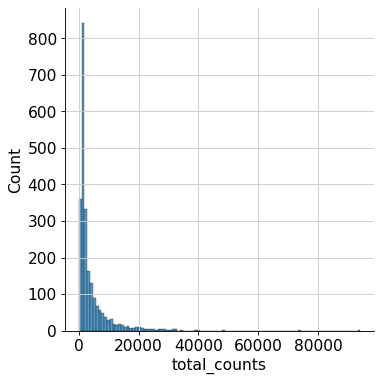

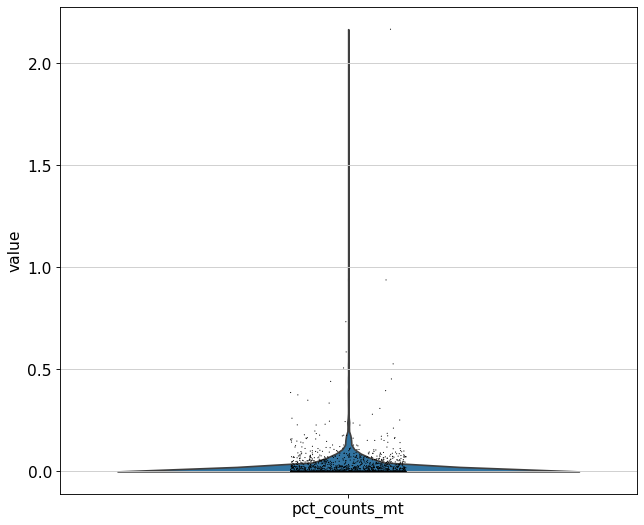

In [18]:
t1 = sns.displot(adata_gex.obs['total_counts'], bins=100, kde=False)
t2 = sc.pl.violin(adata_gex, 'pct_counts_mt')

Note there is quite low MT read fraction (mostly <5%), so might not need to filter on this, unless this coincides with low count depth and low number of genes. 
<br> S1D2: also low MT reads (< 5%)

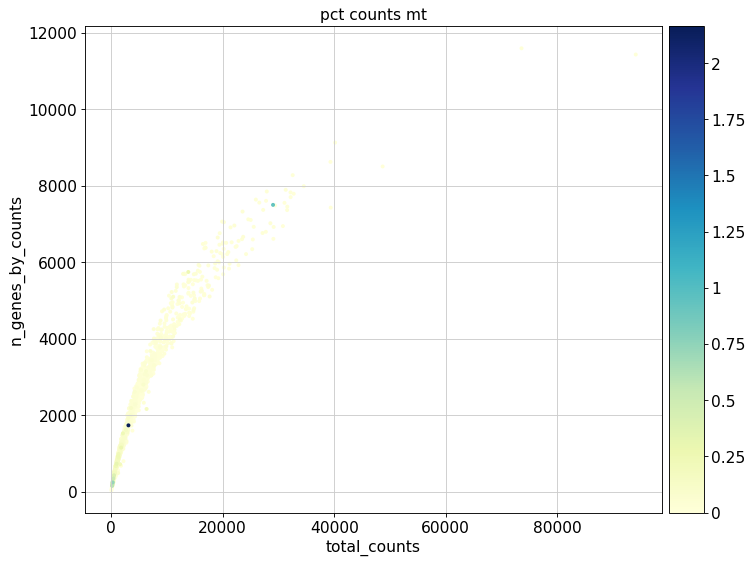

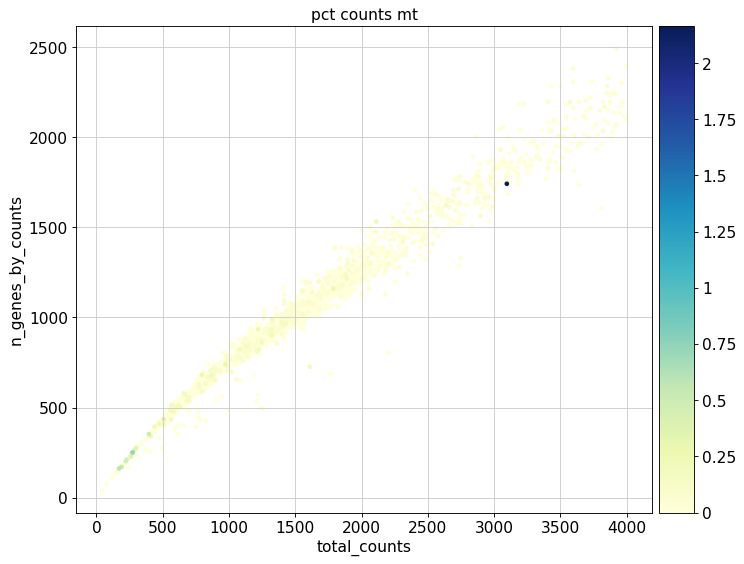

In [19]:
#Data quality summary plots
p1 = sc.pl.scatter(adata_gex, 'total_counts', 'n_genes_by_counts', color='pct_counts_mt')
p2 = sc.pl.scatter(adata_gex[adata_gex.obs['total_counts']<4000], 'total_counts', 'n_genes_by_counts', color='pct_counts_mt')

/srv/conda/envs/saturn/lib/python3.9/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


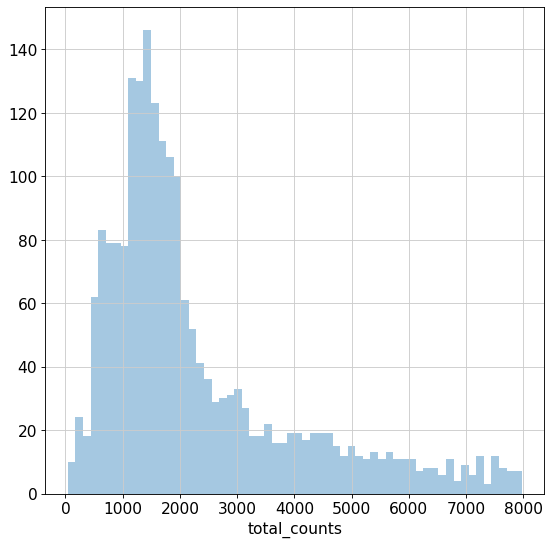

/srv/conda/envs/saturn/lib/python3.9/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


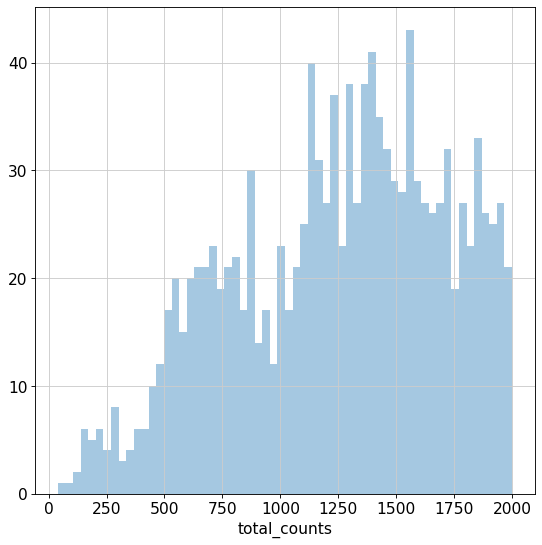

/srv/conda/envs/saturn/lib/python3.9/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


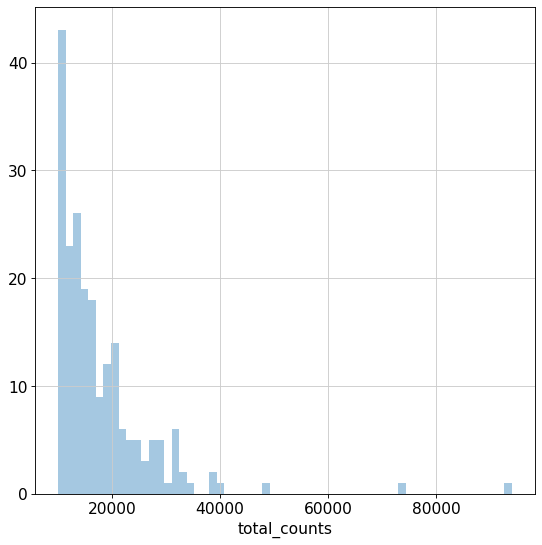

/srv/conda/envs/saturn/lib/python3.9/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


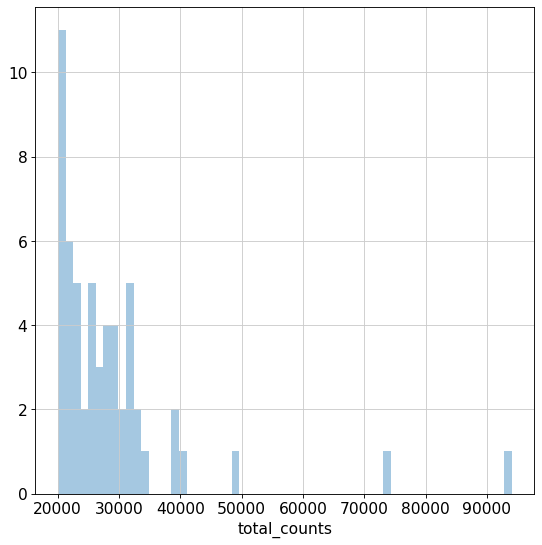

/srv/conda/envs/saturn/lib/python3.9/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


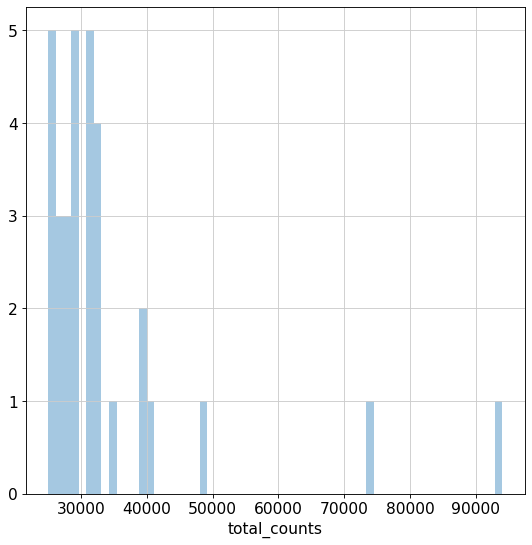

In [20]:
#Thresholding decision: counts
# Here we check the univariate distributions for low-quality outlier peaks. We especially zoom in on lower values
p3 = sns.distplot(adata_gex.obs['total_counts'][adata_gex.obs['total_counts']<8000], kde=False, bins=60)
plt.show()

p4 = sns.distplot(adata_gex.obs['total_counts'][adata_gex.obs['total_counts']<2000], kde=False, bins=60)
plt.show()

p5 = sns.distplot(adata_gex.obs['total_counts'][adata_gex.obs['total_counts']>10000], kde=False, bins=60)
plt.show()

p6 = sns.distplot(adata_gex.obs['total_counts'][adata_gex.obs['total_counts']>20000], kde=False, bins=60)
plt.show()

p7 = sns.distplot(adata_gex.obs['total_counts'][adata_gex.obs['total_counts']>25000], kde=False, bins=60)
plt.show()

Thresholding options:

Lower bound:
- 300 -> use this
- 750
- 1000 

Upper bound:
- 25,000 -> go for this
- 30,000

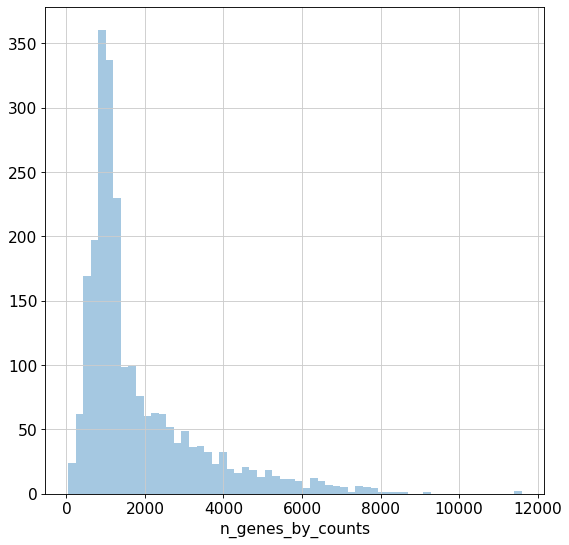

/srv/conda/envs/saturn/lib/python3.9/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


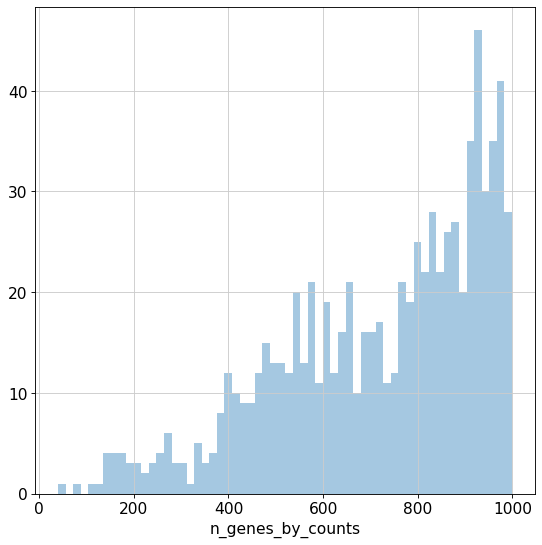

/srv/conda/envs/saturn/lib/python3.9/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


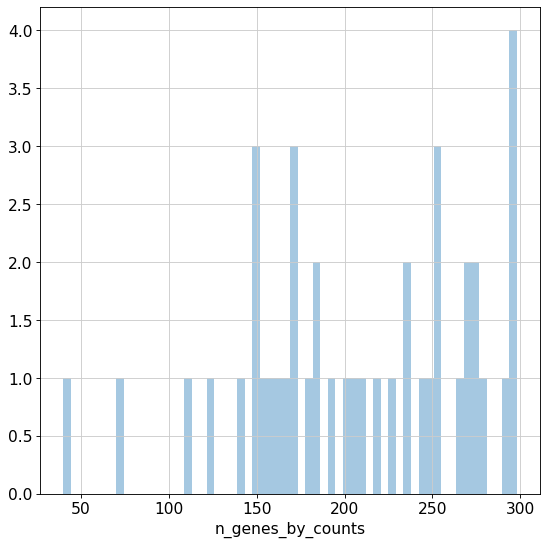

In [21]:
#Thresholding decision: genes
p7 = sns.distplot(adata_gex.obs['n_genes_by_counts'], kde=False, bins=60)
plt.show()

p8 = sns.distplot(adata_gex.obs['n_genes_by_counts'][adata_gex.obs['n_genes_by_counts']<1000], kde=False, bins=60)
plt.show()

p9 = sns.distplot(adata_gex.obs['n_genes_by_counts'][adata_gex.obs['n_genes_by_counts']<300], kde=False, bins=60)
plt.show()

Gene thresholding options:
- 350 -> try this first

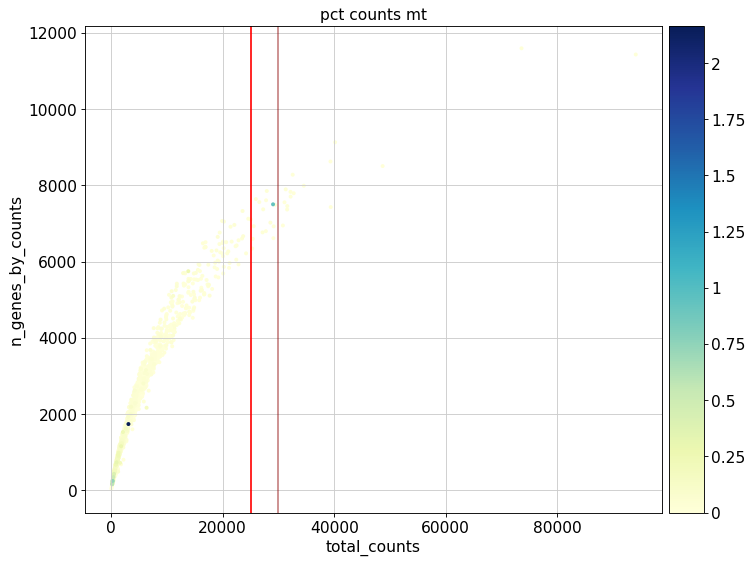

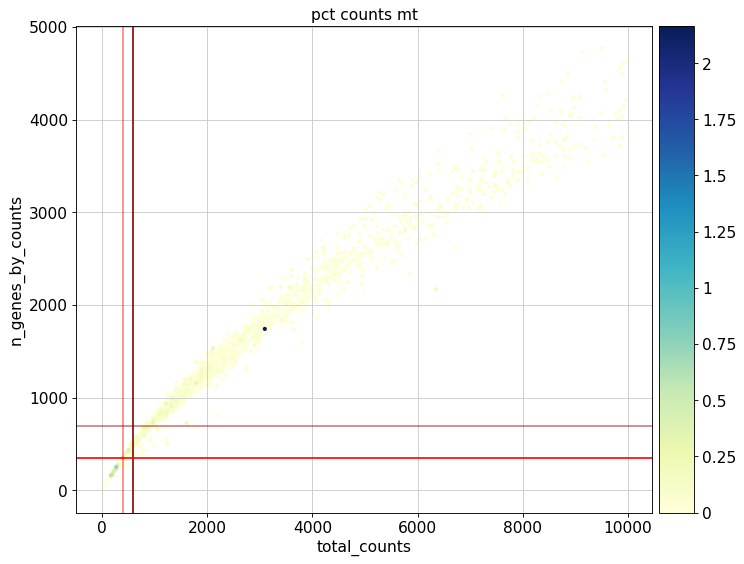

In [22]:
# Visualize the chosen thresholds jointly, before filtering out cells
counts_upper = 25000
counts_upper_alt = 30000
counts_lower = 400
counts_lower_alt = 600
genes_lower = 350
genes_lower_alt = 700

p9 = sc.pl.scatter(adata_gex, 'total_counts', 'n_genes_by_counts', color='pct_counts_mt', show=False)
p9.axline((counts_upper,0),(counts_upper,1), color='red')
p9.axline((counts_upper_alt,0),(counts_upper_alt,1), color='darkred', alpha=0.5)
plt.show()

count_lim = 10000
p10 = sc.pl.scatter(adata_gex[adata_gex.obs['total_counts']<count_lim], 'total_counts', 'n_genes_by_counts', color='pct_counts_mt', show=False)
p10.axline((counts_lower,0),(counts_lower,1), color='red', alpha=0.5)
p10.axline((counts_lower_alt,0),(counts_lower_alt,1), color='darkred')
p10.axline((0,genes_lower),(1,genes_lower), color='red')
p10.axline((0,genes_lower_alt),(1,genes_lower_alt), color='darkred', alpha=0.5)
plt.show()

- Counts lower: 400
- Counts upper: 25000
- Genes: 350 is final
- no MT threshold is needed

In [23]:
# Filter cells according to identified QC thresholds:
print('Total number of cells: {:d}'.format(adata_gex.n_obs))

sc.pp.filter_cells(adata_gex, min_counts = 400)
print('Number of cells after min count filter: {:d}'.format(adata_gex.n_obs))

sc.pp.filter_cells(adata_gex, max_counts = 25000)
print('Number of cells after max count filter: {:d}'.format(adata_gex.n_obs))

sc.pp.filter_cells(adata_gex, min_genes = 350)
print('Number of cells after gene filter: {:d}'.format(adata_gex.n_obs))

Total number of cells: 2355
Number of cells after min count filter: 2309
Number of cells after max count filter: 2277
Number of cells after gene filter: 2272


In [24]:
#Filter genes:
print('Total number of genes: {:d}'.format(adata_gex.n_vars))

# Min 20 cells - filters out 0 count genes
sc.pp.filter_genes(adata_gex, min_cells=20)
print('Number of genes after cell filter: {:d}'.format(adata_gex.n_vars))

Total number of genes: 36601
Number of genes after cell filter: 14208


# Normalization

In [25]:
#Perform a clustering for scran normalization in clusters
adata_pp = adata_gex.copy()
sc.pp.normalize_per_cell(adata_pp, counts_per_cell_after=1e6)
sc.pp.log1p(adata_pp)
sc.pp.pca(adata_pp, n_comps=15)
sc.pp.neighbors(adata_pp)
sc.tl.leiden(adata_pp, key_added='groups', resolution=0.5)

In [26]:
#Preprocess variables for scran normalization
input_groups = adata_pp.obs['groups']
data_mat = adata_gex.X.T.A

In [27]:
%%R -i data_mat -i input_groups -o size_factors

size_factors = sizeFactors(computeSumFactors(SingleCellExperiment(list(counts=data_mat)), clusters=input_groups, min.mean=0.1))

In [28]:
#Delete adata_pp
del adata_pp

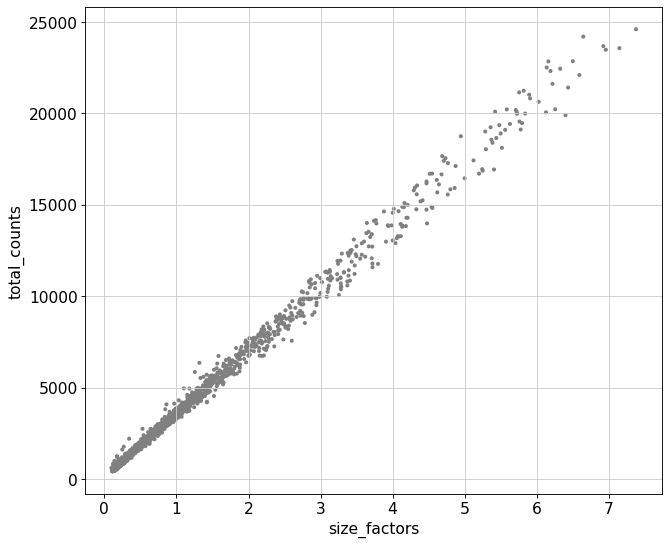

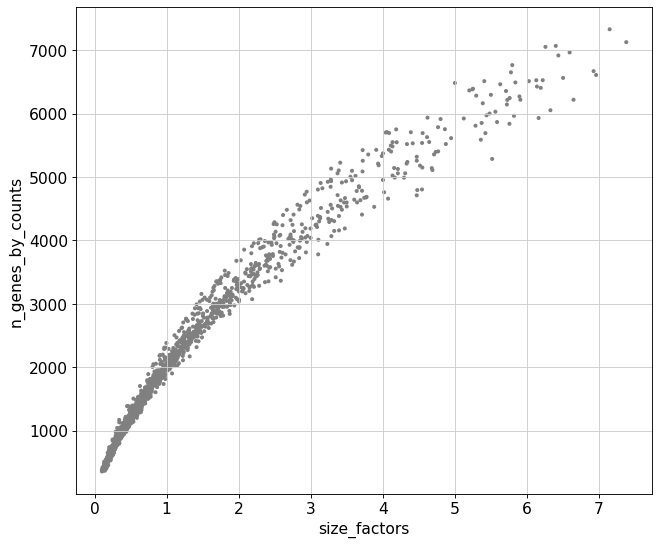

/srv/conda/envs/saturn/lib/python3.9/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


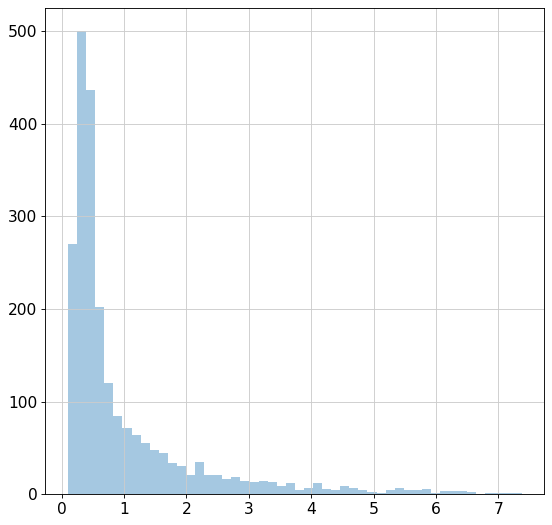

In [29]:
# Visualize the estimated size factors
adata_gex.obs['size_factors'] = size_factors

sc.pl.scatter(adata_gex, 'size_factors', 'total_counts')
sc.pl.scatter(adata_gex, 'size_factors', 'n_genes_by_counts')

sns.distplot(size_factors, bins=50, kde=False)
plt.show()

No size factorss are below 0, and the range of size factors is manageable (not >10, and mostly <4)

In [30]:
#Keep the count data in a counts layer
adata_gex.layers["counts"] = adata_gex.X.copy()

#Normalize adata 
adata_gex.X /= adata_gex.obs['size_factors'].values[:,None]
sc.pp.log1p(adata_gex)

#Transform back into a sparse matrix
adata_gex.X = sp.sparse.csr_matrix(adata_gex.X)

#Store the full data set in 'raw' as log-normalised data for statistical testing
adata_gex.raw = adata_gex

# HVGs

In [31]:
sc.pp.highly_variable_genes(adata_gex, flavor='cell_ranger', n_top_genes=4000)
print('\n','Number of highly variable genes: {:d}'.format(np.sum(adata_gex.var['highly_variable'])))


 Number of highly variable genes: 4000


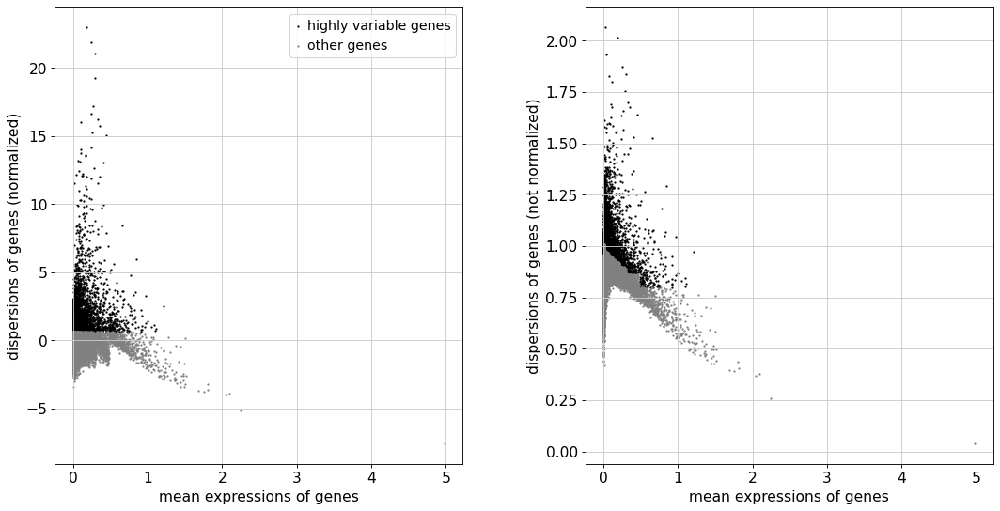

In [32]:
sc.pl.highly_variable_genes(adata_gex)

# Visualization

In [33]:
# Calculate the visualizations
sc.pp.pca(adata_gex, n_comps=50, use_highly_variable=True, svd_solver='arpack')
sc.pp.neighbors(adata_gex)
sc.tl.umap(adata_gex)

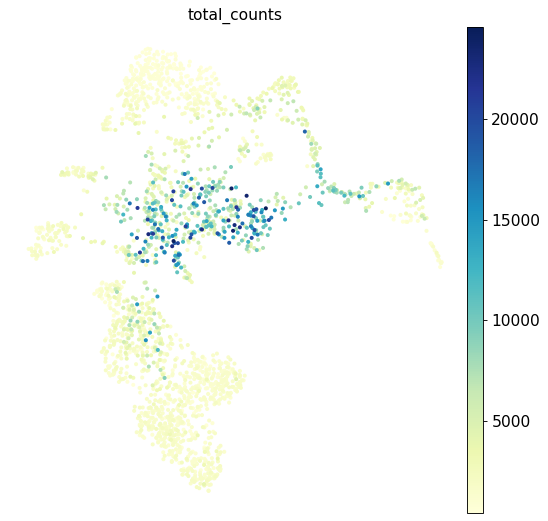

In [34]:
sc.pl.umap(adata_gex, color='total_counts')

We see a high count area aggregated in the middle of the UMAP... this can be problematic, but we can deal with this later as well.

# CC scoring

In [35]:
cc_genes_file = '/home/jovyan/project/gene_lists/Macosko_cell_cycle_genes.txt'

In [36]:
#Score cell cycle and visualize the effect:
cc_genes = pd.read_table(cc_genes_file, delimiter='\t')
s_genes = cc_genes['S'].dropna()
g2m_genes = cc_genes['G2.M'].dropna()

s_genes_ens = adata_gex.var_names[np.in1d(adata_gex.var_names, s_genes)]
g2m_genes_ens = adata_gex.var_names[np.in1d(adata_gex.var_names, g2m_genes)]

sc.tl.score_genes_cell_cycle(adata_gex, s_genes=s_genes_ens, g2m_genes=g2m_genes_ens)

... storing 'phase' as categorical


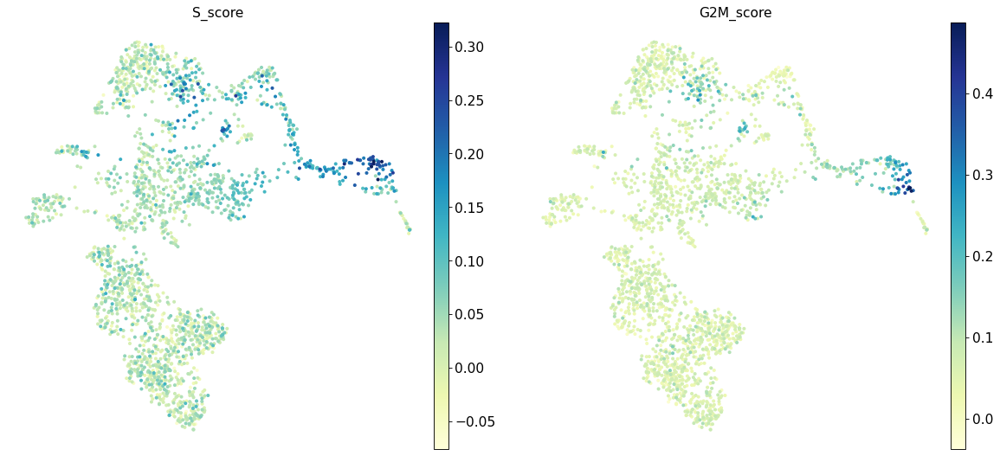

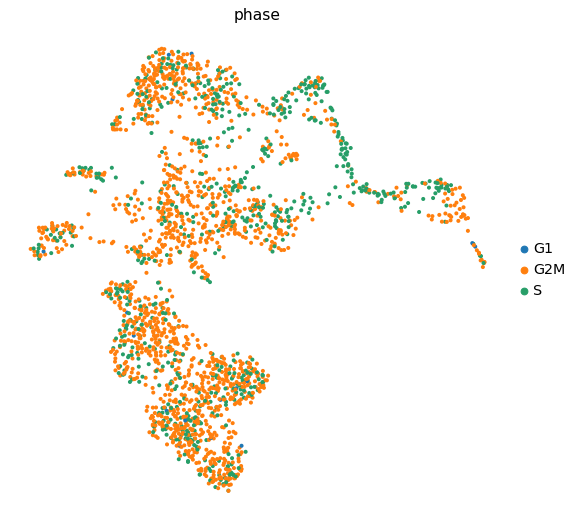

In [37]:
sc.pl.umap(adata_gex, color=['S_score', 'G2M_score'], use_raw=False)
sc.pl.umap(adata_gex, color='phase', use_raw=False)

There is 1 cluster with a clear cell cycle separation, this is likely cycling erythroblasts. This gives the first hint at where the erythrocyte differentiation trajectory is.

# Clustering

Let the fun begin! First step, cluster at several resolutions and select the resolution that broadly captures the structure you see in the UMAP. Try to avoid getting into detailed substructure already at this early stage.

In [38]:
sc.tl.leiden(adata_gex, resolution=0.3, key_added='leiden_res0.3')
sc.tl.leiden(adata_gex, resolution=0.5, key_added='leiden_res0.5')
sc.tl.leiden(adata_gex, resolution=0.8, key_added='leiden_res0.8')
sc.tl.leiden(adata_gex, resolution=1, key_added='leiden_res1')

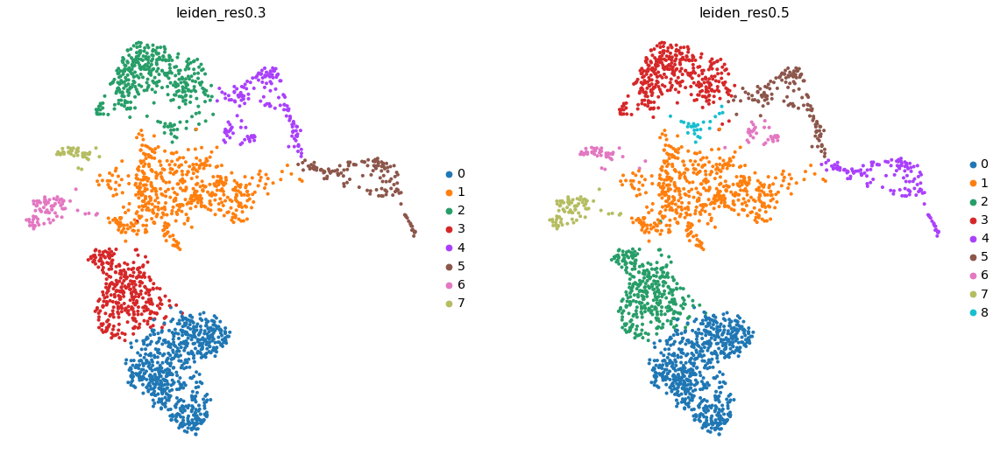

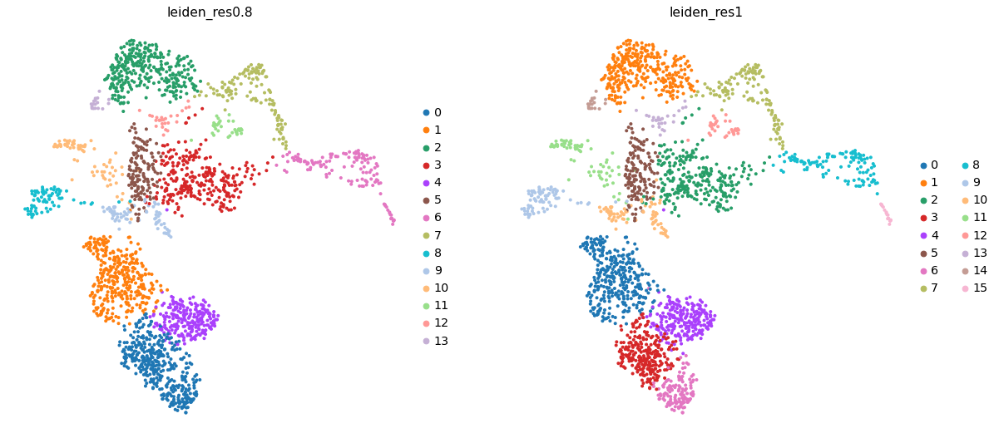

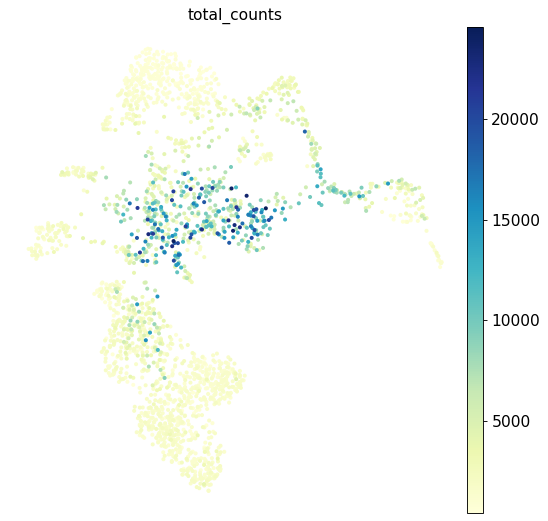

In [39]:
sc.pl.umap(adata_gex, color=['leiden_res0.3', 'leiden_res0.5'])
sc.pl.umap(adata_gex, color=['leiden_res0.8', 'leiden_res1'])
sc.pl.umap(adata_gex, color='total_counts')

Check which clusters have the problematic aggregation of high-count cells... these might be difficult to annotate and could be doublets.

# Doublet detection

Doublet detection to gain extra evidence for which cells are actually two separate cells that happen to be assigned to the same barcode (doublets).

In [40]:
test_dat = adata_gex.copy()
test_dat.X = adata_gex.raw.X

In [41]:
sc.external.pp.scrublet(test_dat)

/srv/conda/envs/saturn/lib/python3.9/site-packages/scanpy/preprocessing/_normalization.py:138: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.44
Detected doublet rate = 0.3%
Estimated detectable doublet fraction = 4.5%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 6.9%


(<Figure size 640x240 with 2 Axes>,
 array([<AxesSubplot:title={'center':'Observed transcriptomes'}, xlabel='Doublet score', ylabel='Prob. density'>,
        <AxesSubplot:title={'center':'Simulated doublets'}, xlabel='Doublet score', ylabel='Prob. density'>],
       dtype=object))

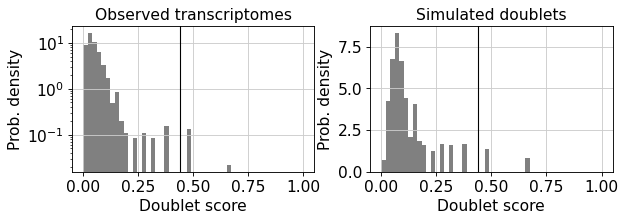

In [42]:
sc.external.pl.scrublet_score_distribution(test_dat)

The distribution of simulated doublets show that potentially a score over 0.25 is already indicative of a doublet. Note that not all doublets will be detectable in this way and it will be more valuable to remove entire clusters based on these scores.

In [43]:
adata_gex.obs['doublet_score'] = test_dat.obs['doublet_score']
adata_gex.obs['predicted_doublet'] = test_dat.obs['predicted_doublet'].astype(str)

In [44]:
del test_dat

... storing 'predicted_doublet' as categorical


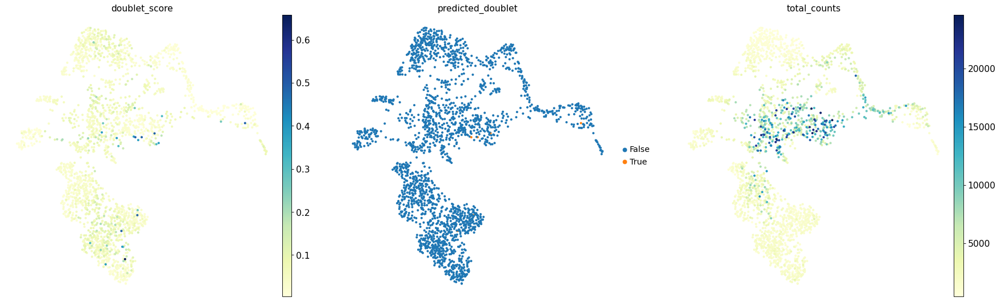

In [45]:
sc.pl.umap(adata_gex, color=['doublet_score', 'predicted_doublet', 'total_counts'])

# Marker genes

In [185]:
#RNA
marker_genes = {
    'CD14+ Mono': ['FCN1', 'CD14'],
    'CD16+ Mono': ['TCF7L2', 'FCGR3A', 'LYN'],
    'ID2-hi myeloid prog': ['CD14', 'ID2', 'VCAN', 'S100A9', 'CLEC12A', 'KLF4', 'PLAUR'],
    'cDC2': ['CST3', 'COTL1', 'LYZ', 'DMXL2'], # Note: DMXL2 should be negative
    'Reticulocyte': ['SLC4A1', 'SLC25A37', 'HBB', 'HBA2', 'HBA1', 'TFRC'],
    'Erythroblast': ['MKI67', 'HBA1', 'HBB'],
    'Proerythroblast': ['CDK6', 'SYNGR1', 'HBM', 'GYPA'], # Note HBM and GYPA are negative markers
    'NK': ['GNLY', 'NKG7', 'CD247', 'GRIK4'],
    'ILC': ['ID2', 'PLCG2', 'GNLY', 'SYNE1'],
    'Lymph prog': ['IGLL1', 'MME', 'EBF1', 'SSBP2', 'BACH2', 'CD79B', 'IGHM', 'PAX5', 'PRKCE'],
    'Naive CD20+ B': ['MS4A1', 'IL4R', 'IGHD', 'FCRL1', 'IGHM'],
    'B1 B': ['MS4A1', 'SSPN', 'ITGB1', 'EPHA4', 'COL4A4', 'IGHD', 'IGHM'], # Note IGHD and IGHM are negative markers
    'Transitional B': ['MME', 'CD38', 'CD24', 'ACSM3', 'MSI2'],
    'Plasma cells': ['MZB1', 'HSP90B1', 'FNDC3B', 'PRDM1', 'IGKC', 'JCHAIN'],
    'CD4+ T activated': ['CD4', 'IL7R', 'TRBC2', 'ITGB1'],
    'CD4+ T naive': ['CD4', 'IL7R', 'TRBC2'],
    'CD8+ T': ['CD8A', 'CD8B', 'GZMB', 'GZMA'],
    'pDCs': ['GZMB', 'IL3RA', 'COBLL1', 'TCF4'],
    'G/M prog': ['MPO', 'BCL2', 'KCNQ5', 'CSF3R', 'PRTN3'],
    'HSC': ['NRIP1', 'MECOM', 'PROM1', 'CD34', 'NKAIN2'],
    'MK/E prog': ['ZNF385D', 'ITGA2B', 'RYR3', 'PLCB1']
}

- Removed CRACD from Proerythroblast markers because not expressed in dataset and was getting errors

In [47]:
sc.tl.rank_genes_groups(adata_gex, groupby='leiden_res0.3', key_added='rank_genes_res0.3')

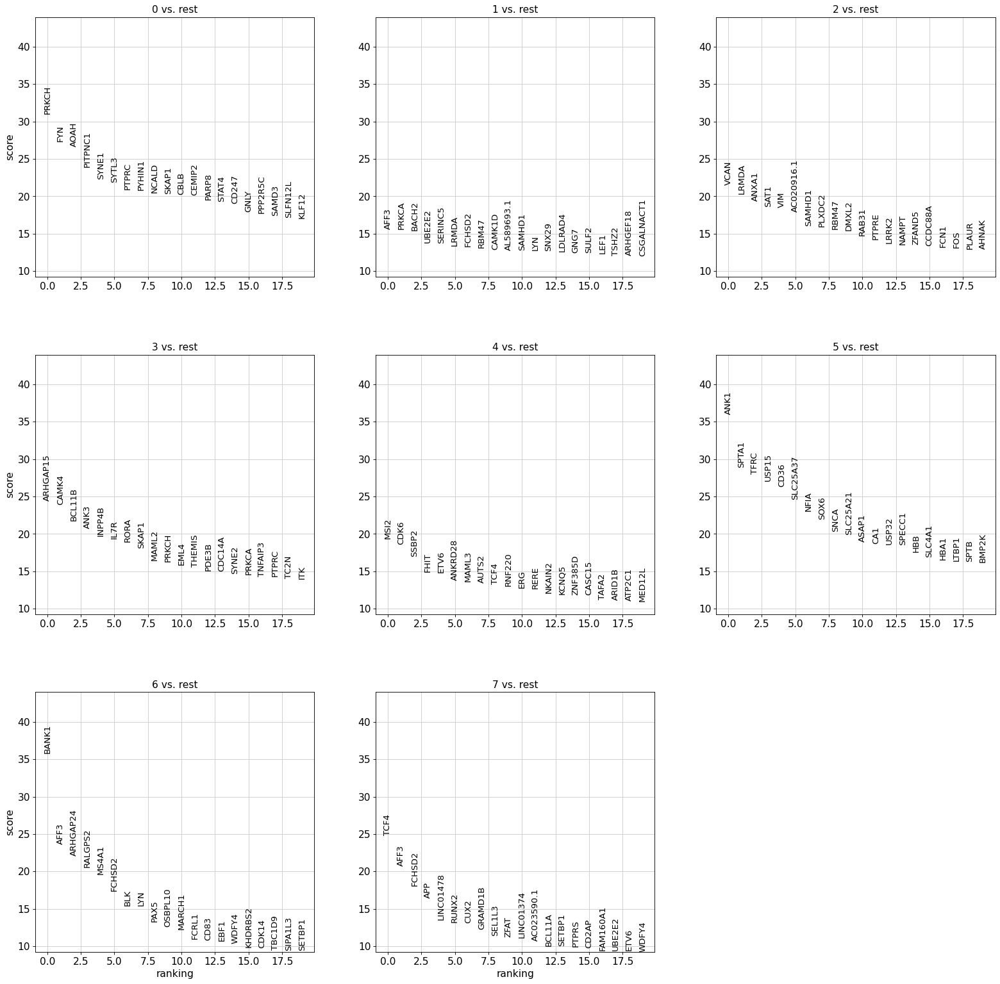

In [48]:
sc.pl.rank_genes_groups(adata_gex, key='rank_genes_res0.3', ncols=3, fontsize=12)

## Literature markers

In [49]:
from matplotlib import colors

In [50]:
#Define a nice colour map for gene expression
colors2 = plt.cm.Reds(np.linspace(0, 1, 128))
colors3 = plt.cm.Greys_r(np.linspace(0.7,0.8,3))
colorsComb = np.vstack([colors3, colors2])
mymap = colors.LinearSegmentedColormap.from_list('my_colormap', colorsComb)

<AxesSubplot:>

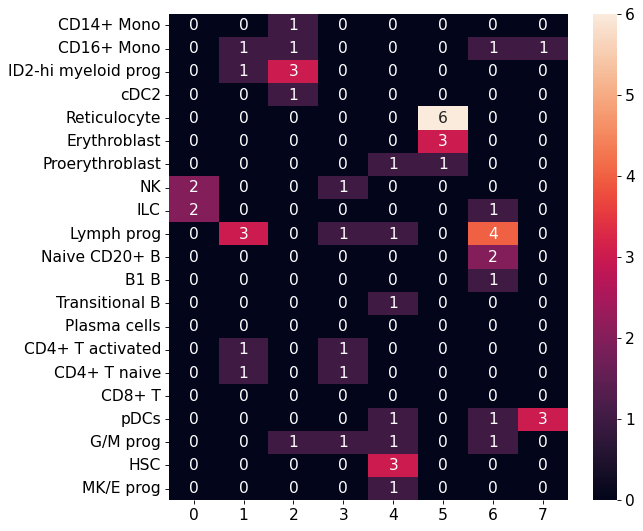

In [159]:
sns.heatmap(sc.tl.marker_gene_overlap(adata_gex, reference_markers=marker_genes, key='rank_genes_res0.3'), annot=True)

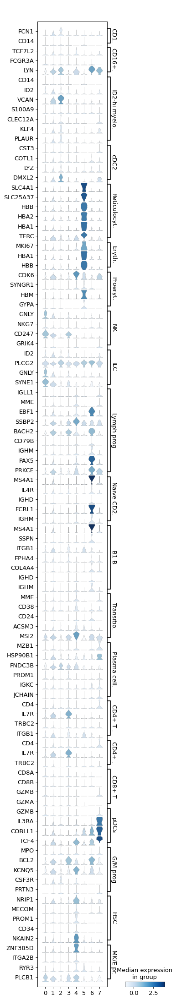

In [160]:
# Look at the marker genes in a concise manner
filt_marker_genes = dict()
for key,val in marker_genes.items():
    filt_vals = [i for i in val if i in adata_gex.var_names]
    filt_marker_genes[key] = filt_vals

adata_plot = adata_gex.copy()
sc.pp.scale(adata_plot, max_value=5)
    
sc.pl.stacked_violin(adata_plot, var_names = filt_marker_genes, groupby='leiden_res0.3', use_raw=False, swap_axes=True)

Cluster: CD14+ Mono


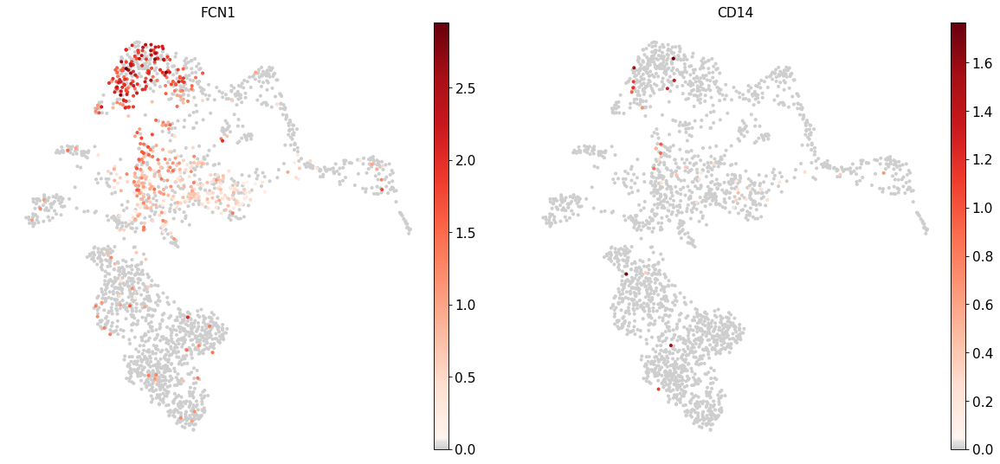

Cluster: CD16+ Mono


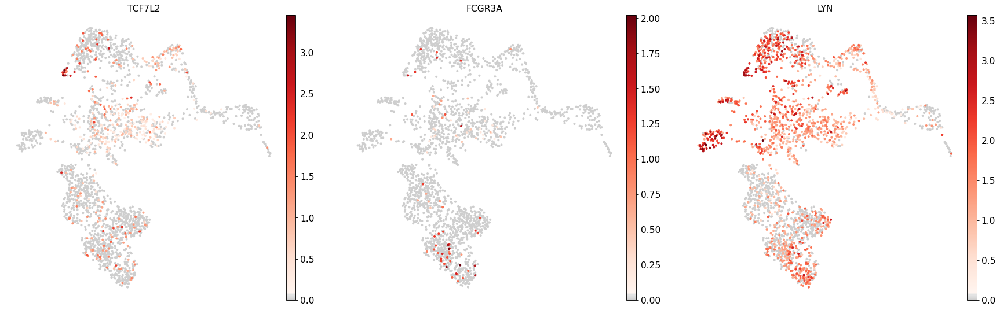

Cluster: ID2-hi myeloid prog


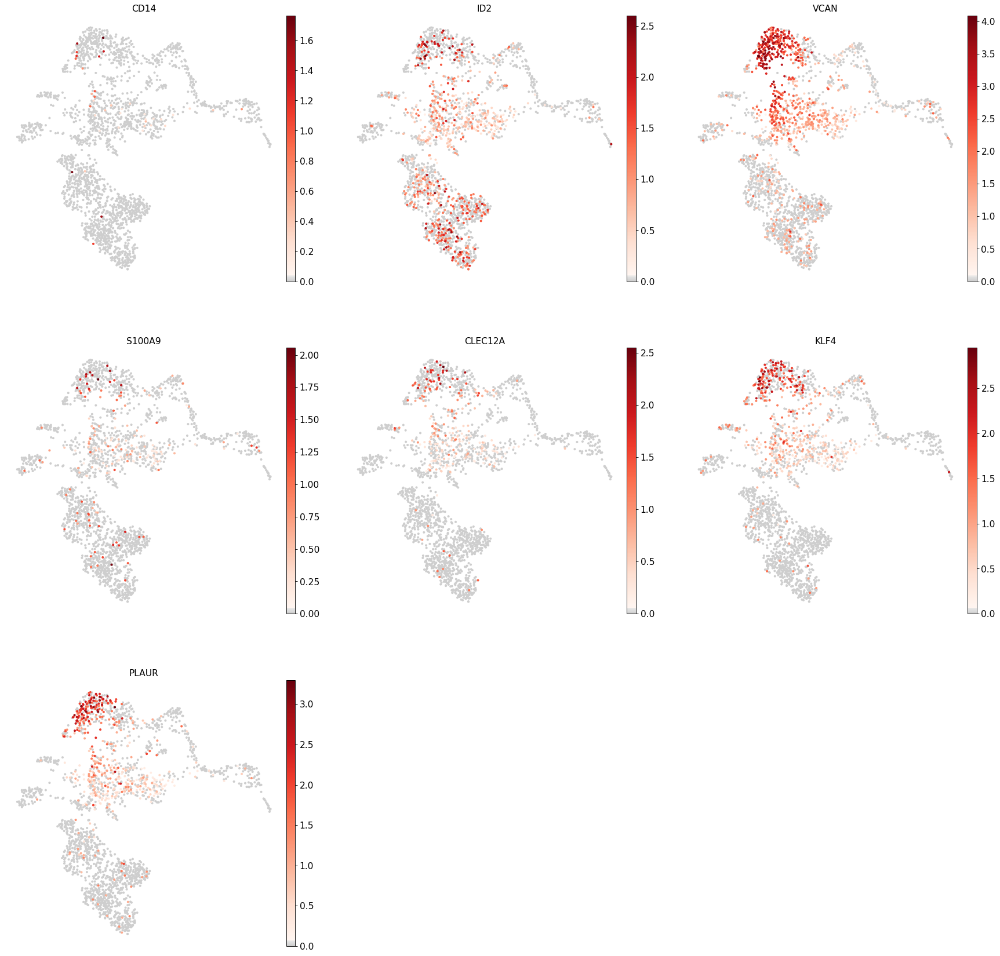

Cluster: cDC2


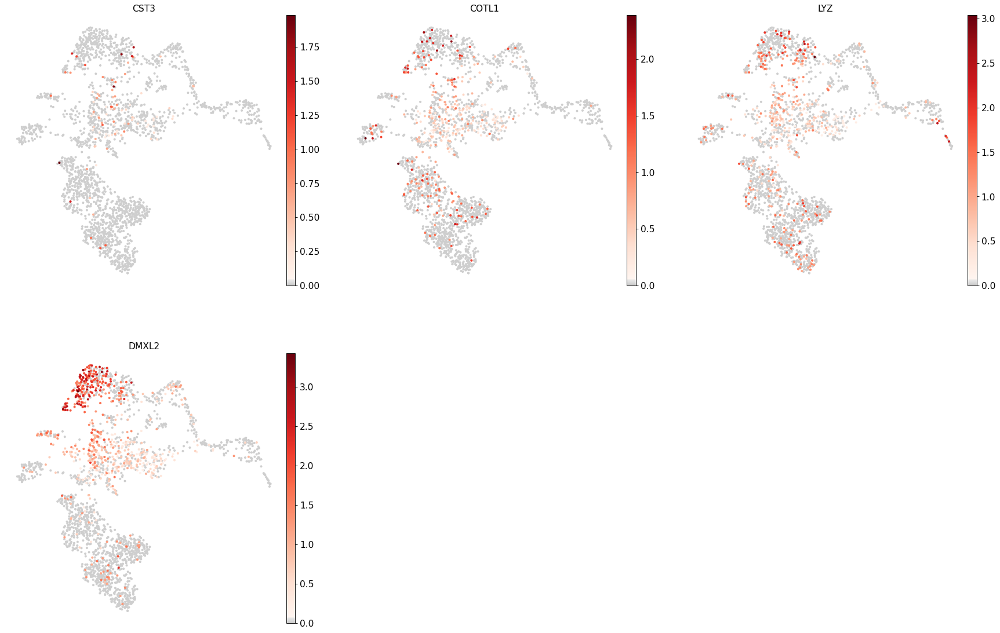

Cluster: Reticulocyte


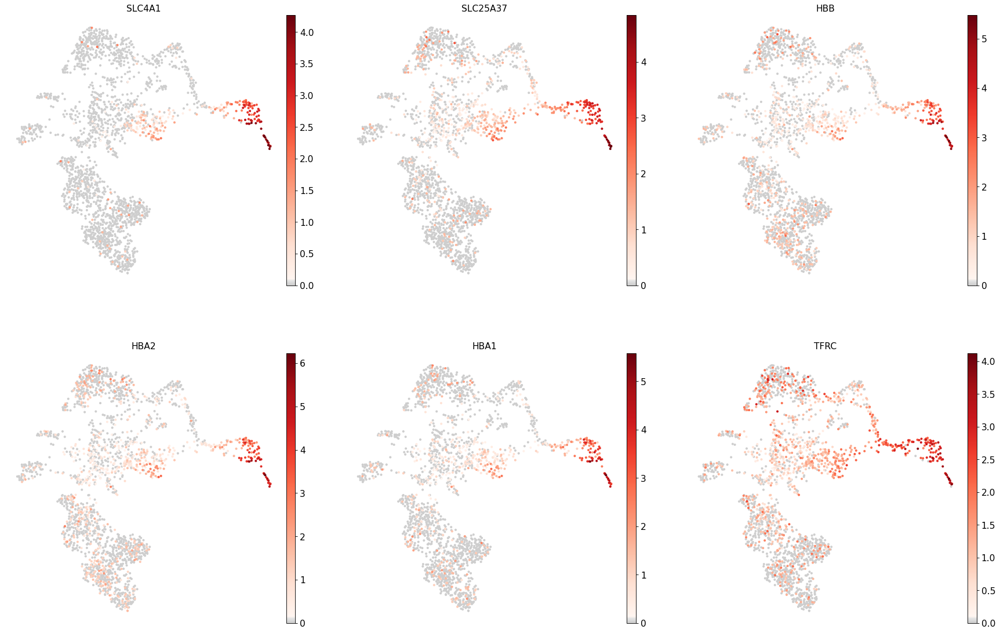

Cluster: Erythroblast


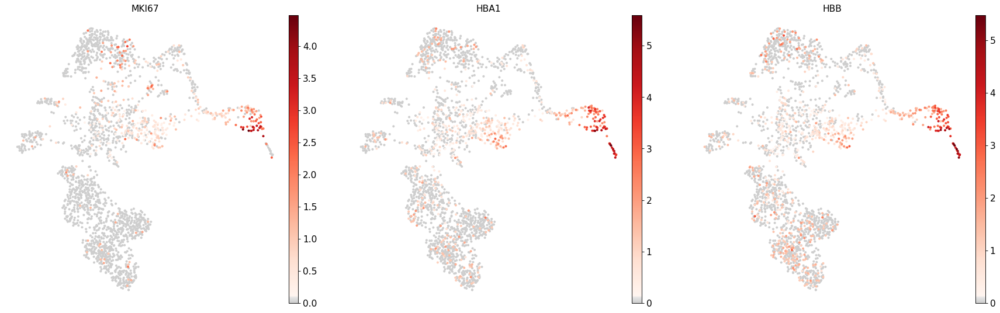

Cluster: Proerythroblast


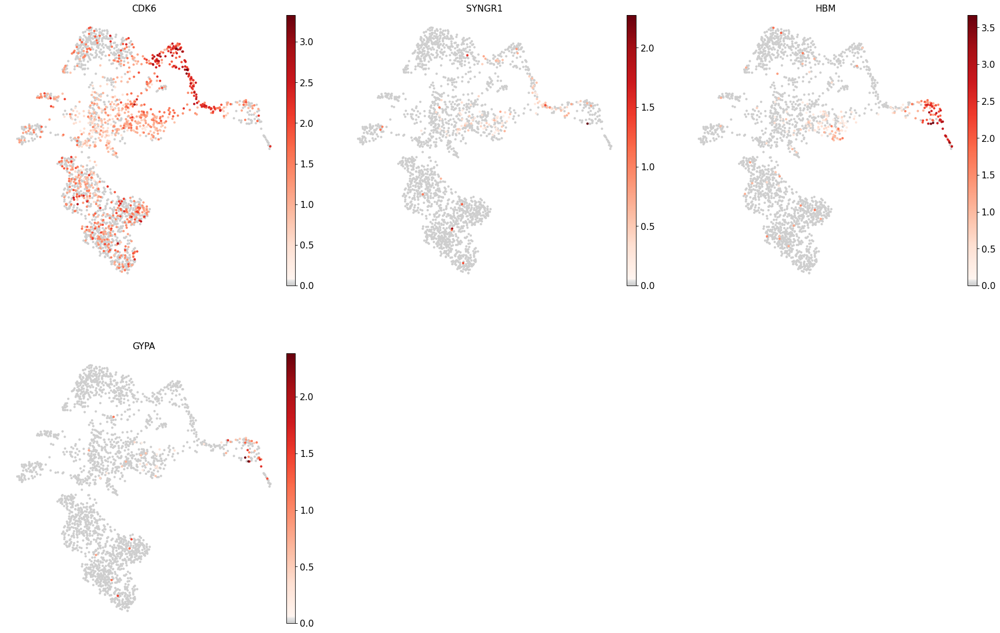

Cluster: NK


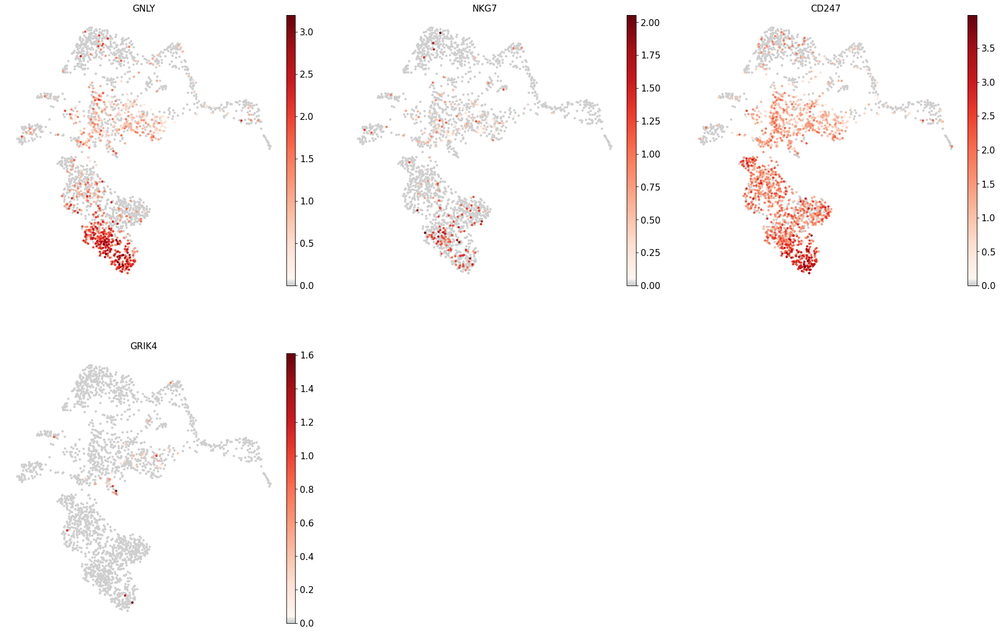

Cluster: ILC


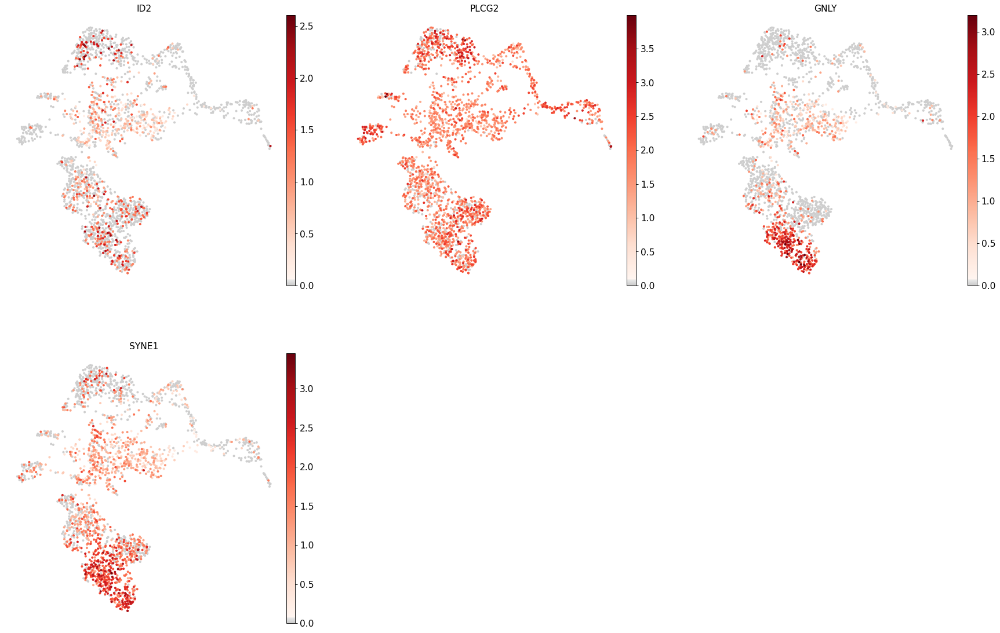

Cluster: Lymph prog


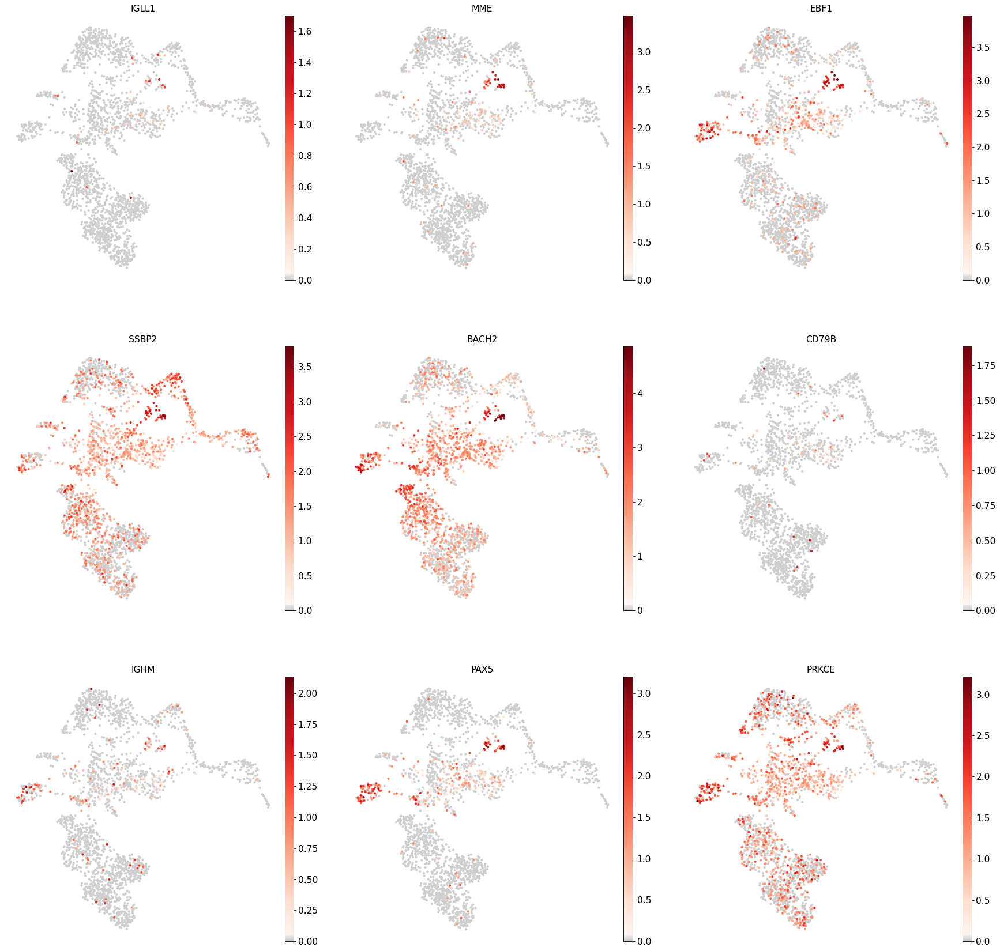

Cluster: Naive CD20+ B


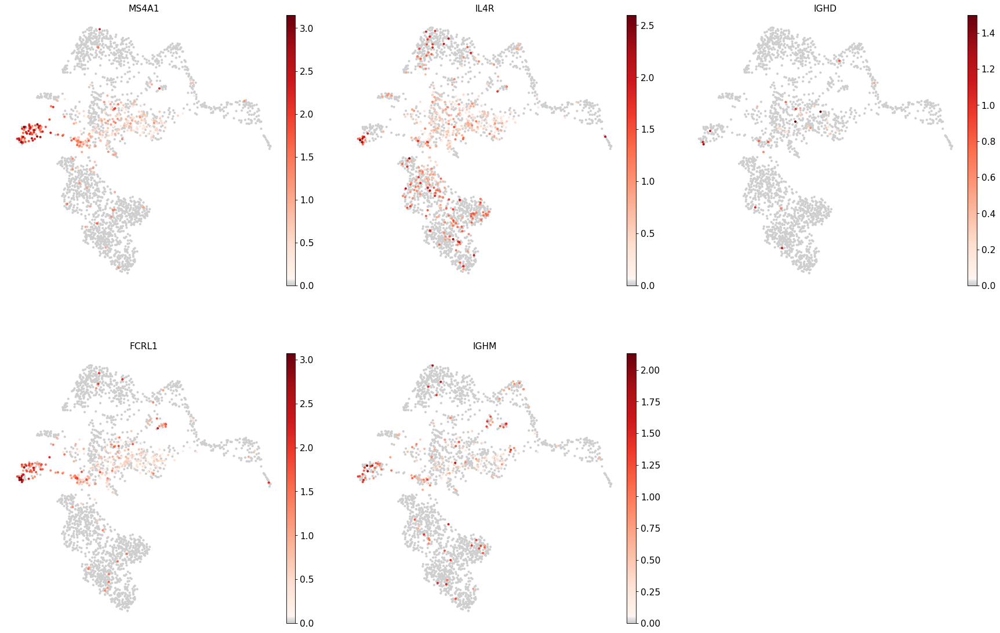

Cluster: B1 B


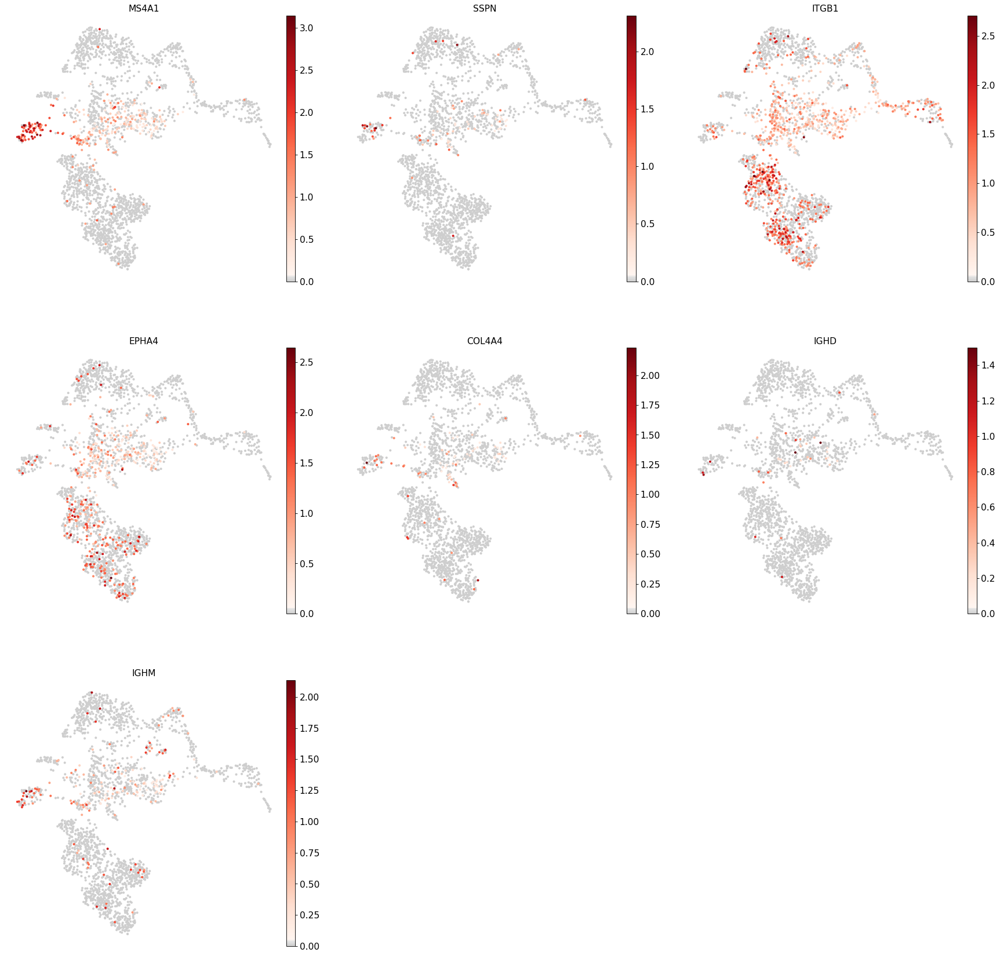

Cluster: Transitional B


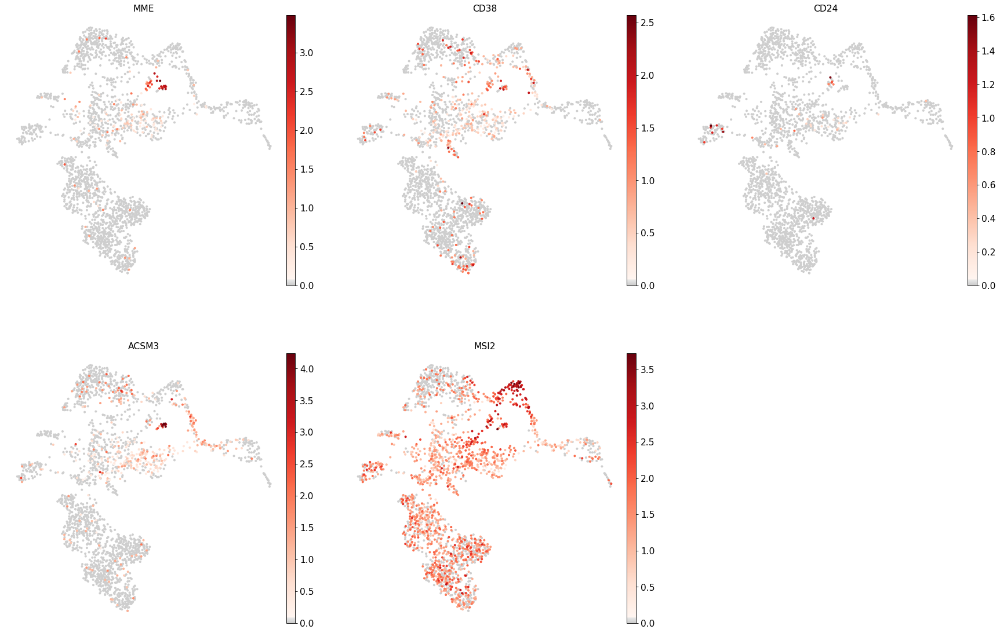

Cluster: Plasma cells


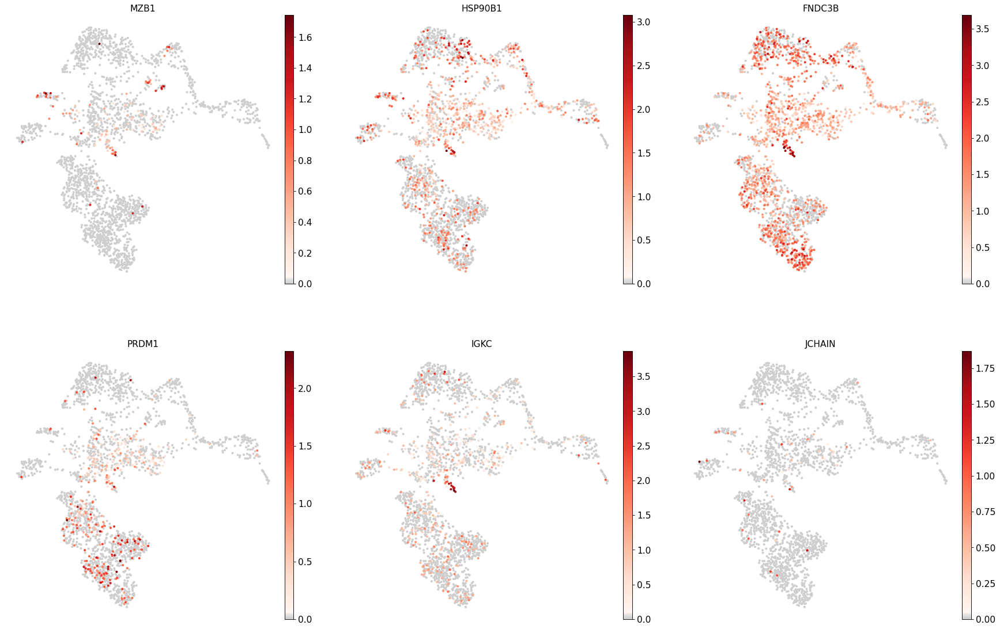

Cluster: CD4+ T activated


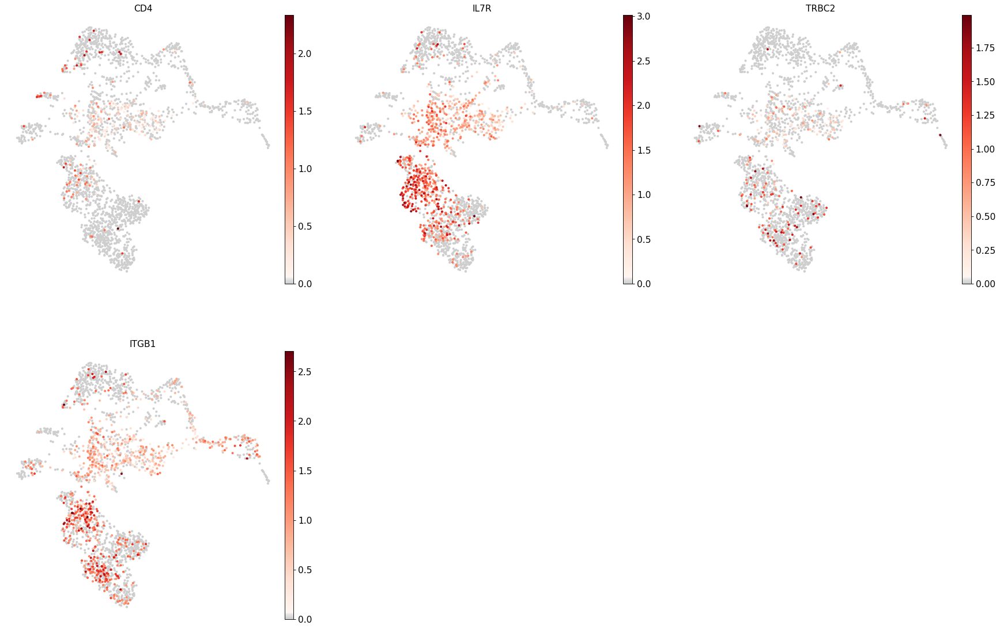

Cluster: CD4+ T naive


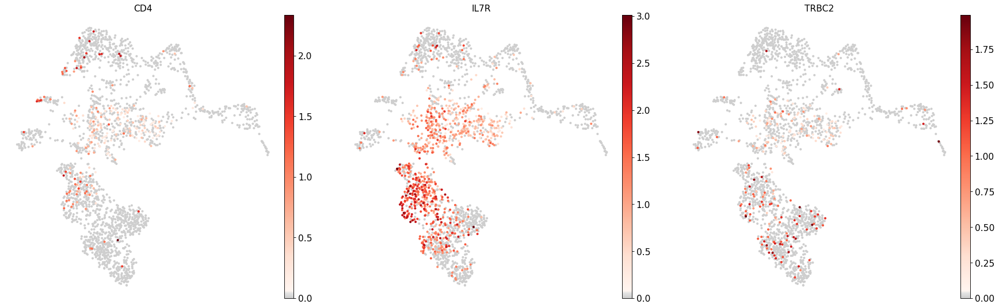

Cluster: CD8+ T


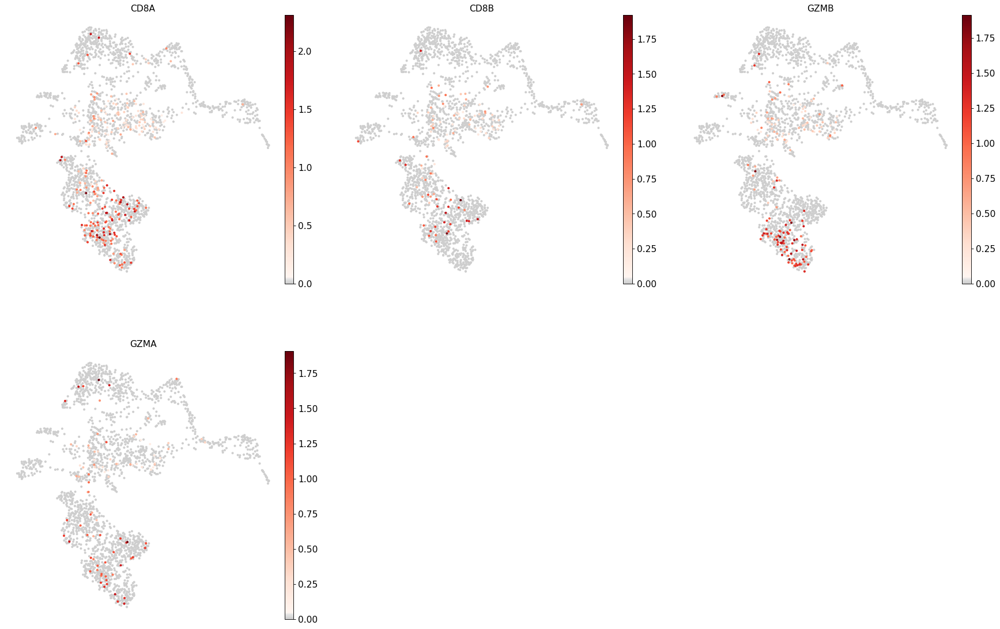

Cluster: pDCs


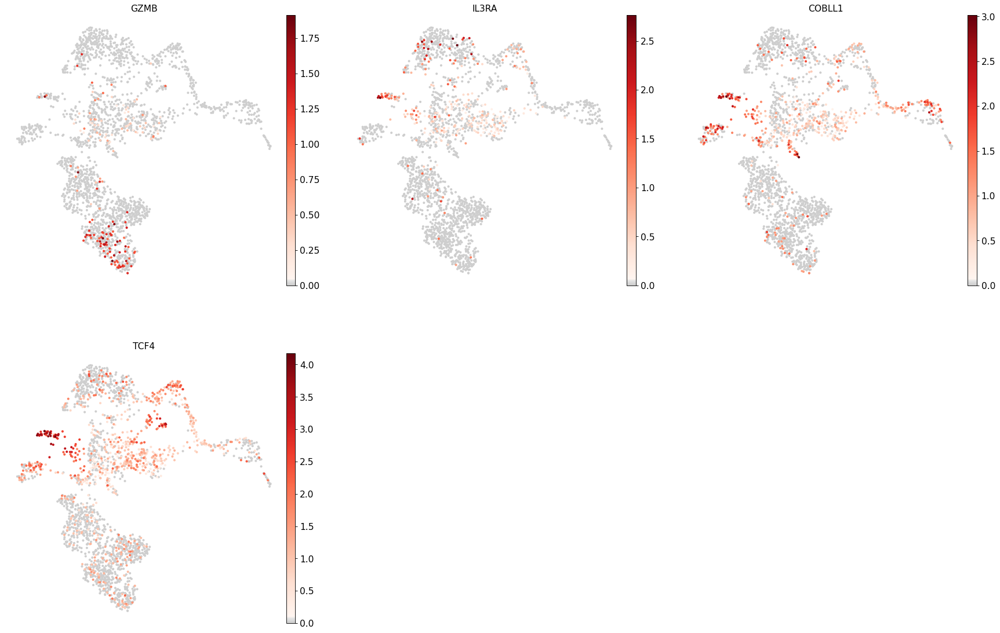

Cluster: G/M prog


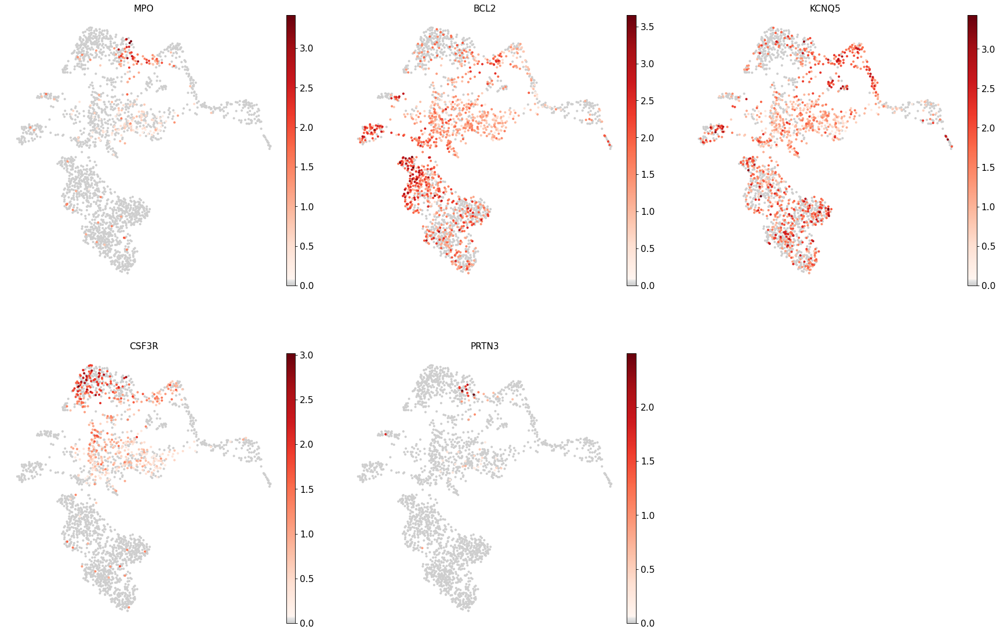

Cluster: HSC


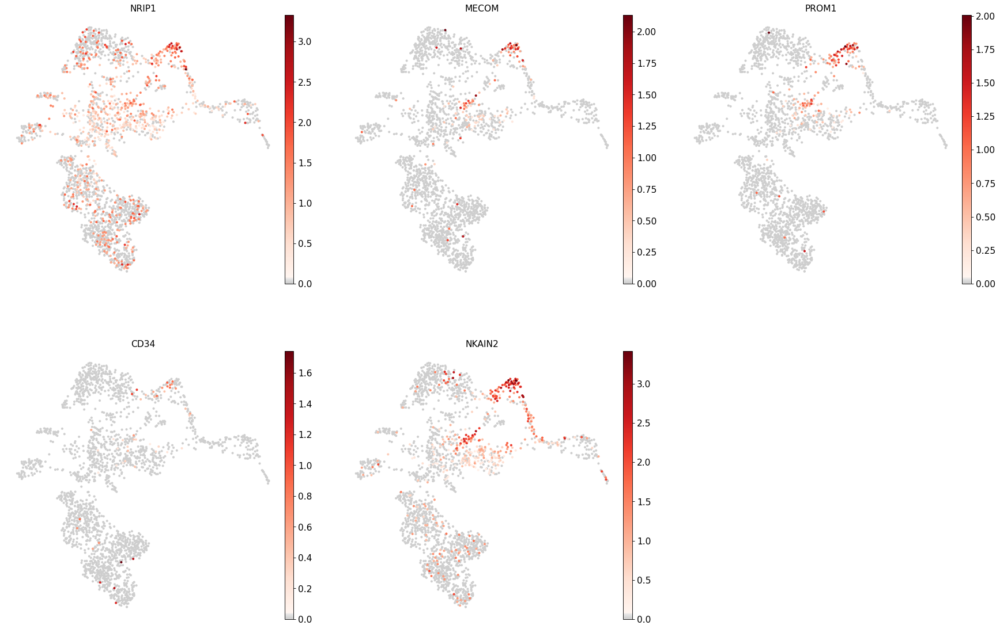

Cluster: MK/E prog


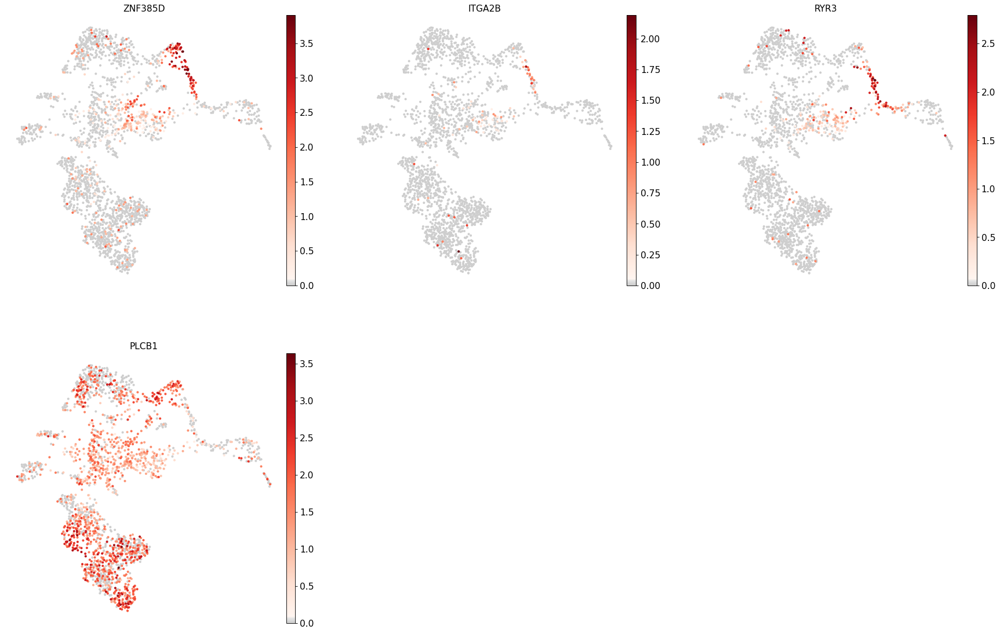

In [161]:
# Look at marker expression 
# Note that some markers are meant to be negative! (DMXL2, HBM, GYPA, IGHD, IGHM for some cell types)
for i in marker_genes.keys():
    print(f'Cluster: {i}')
    genes_to_plot = [i for i in marker_genes[i] if i in adata_gex.var_names]
    sc.pl.umap(adata_gex, color=genes_to_plot, ncols=3, use_raw=False, cmap=mymap)

Marker genes suggest:
- 0: NK / ILC / CD8+ T 
- 1: plasma cells / lymph prog / CD14+ Mono / CD16+ Mono / CD4+ T activated / CD4+ T naive / doublets?
- 2: CD14+ Mono / CD16+ Mono / ID2-hi myeloid prog / G/M prog / cDC2
- 3: CD4+ T activated / CD4+ T naive / HSPC/Mono prog
- 4: Lymph prog / transitional B / HSC / MK/E prog
- 5: Reticulocyte / erythroblast / proerythroblast
- 6: Naive CD20+ B / Lymph prog / B1 B
- 7: pDCs

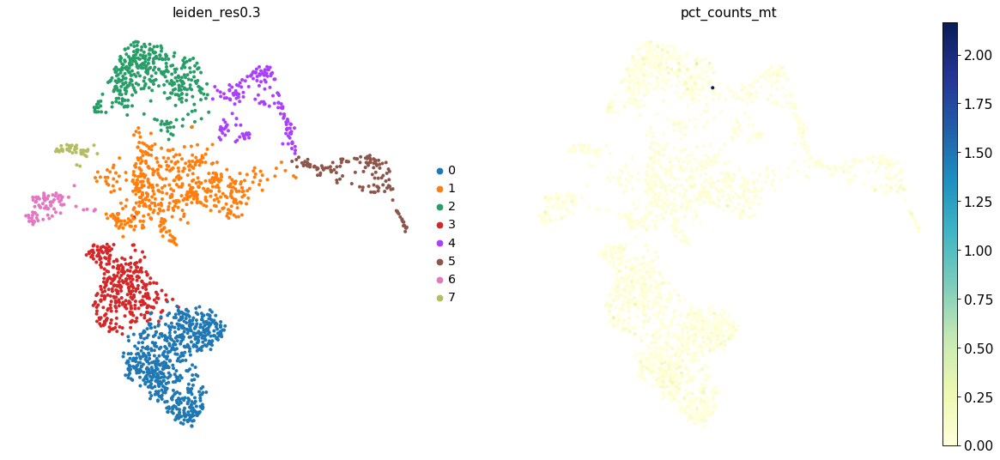

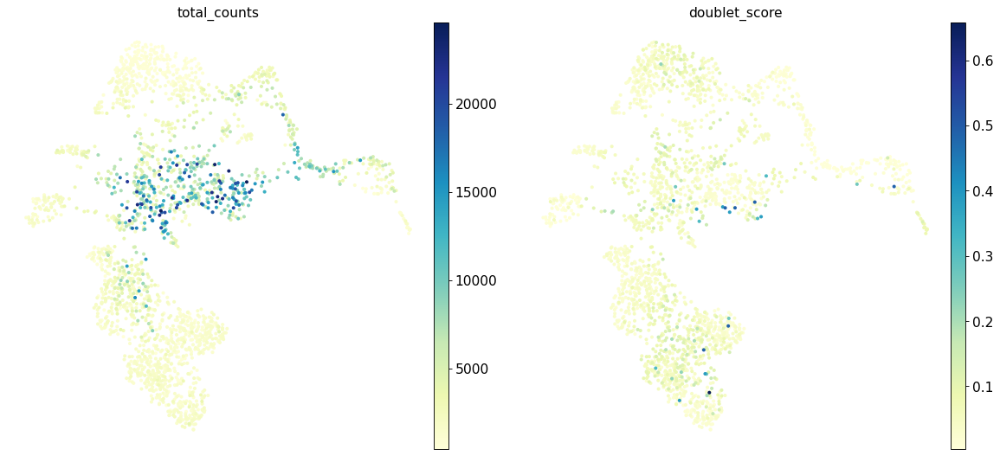

In [162]:
# Check some technical markers to assess potential doublet or low quality clusters
sc.pl.umap(adata_gex, color=['leiden_res0.3', 'pct_counts_mt'])
sc.pl.umap(adata_gex, color=['total_counts', 'doublet_score'])

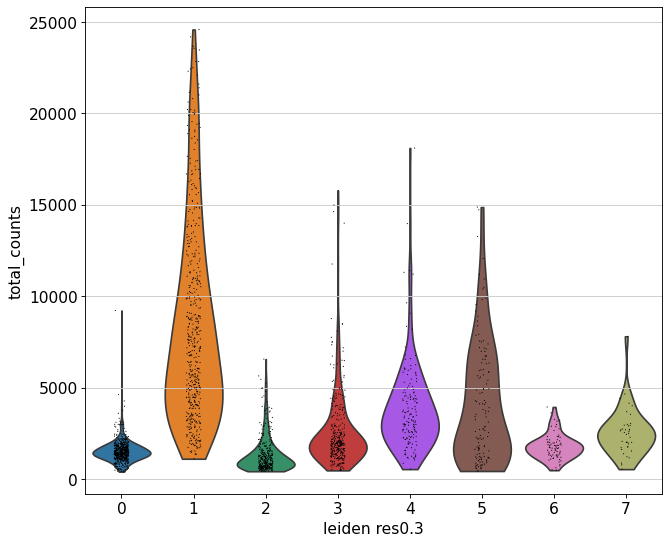

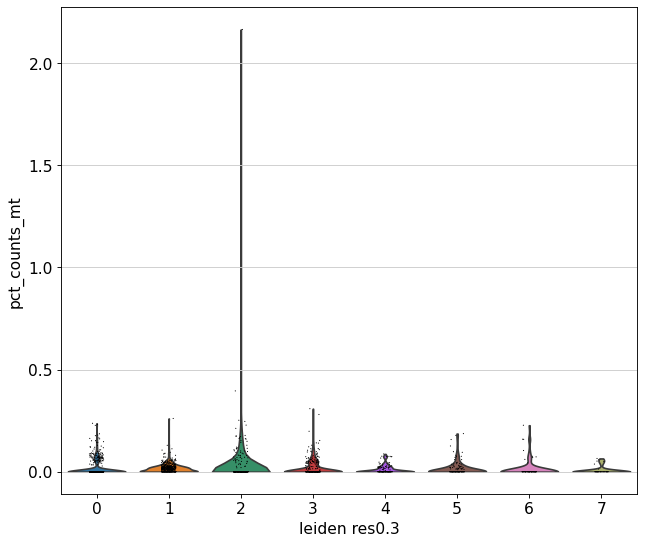

In [163]:
sc.pl.violin(adata_gex, keys='total_counts', groupby='leiden_res0.3')
sc.pl.violin(adata_gex, keys='pct_counts_mt', groupby='leiden_res0.3')

# Subclustering

Note that you will likely need to adapt the `resolution` parameter to optimally represent the substructure you see in the data.

## Cluster 0 

In [164]:
orig_key = 'leiden_res0.3'
new_key = 'leiden_res0.3_sub0'
new_rg_key = 'rg_res0.3_sub0'
sub_key = '0'

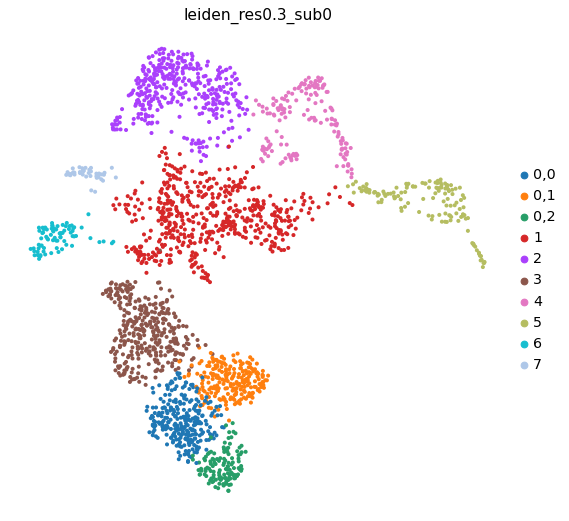

1      520
2      370
3      347
0,0    272
0,1    228
4      158
5      132
0,2    128
6       77
7       40
Name: leiden_res0.3_sub0, dtype: int64

In [165]:
res = 0.3
sc.tl.leiden(adata_gex, restrict_to=('leiden_res0.3', [sub_key]), key_added=new_key, resolution=res)
sc.pl.umap(adata_gex, color=new_key)
adata_gex.obs[new_key].value_counts()

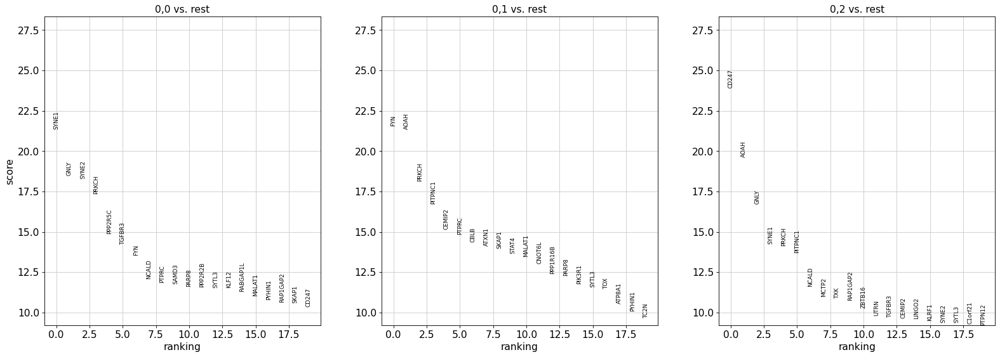

In [166]:
# Find markers of subclusters
num_subclusts = 3
new_groups = [sub_key+','+str(i) for i in range(num_subclusts)]
sc.tl.rank_genes_groups(adata_gex, groupby=new_key, key_added=new_rg_key, groups=new_groups)
sc.pl.rank_genes_groups(adata_gex, key=new_rg_key, groups=new_groups, ncols=3)

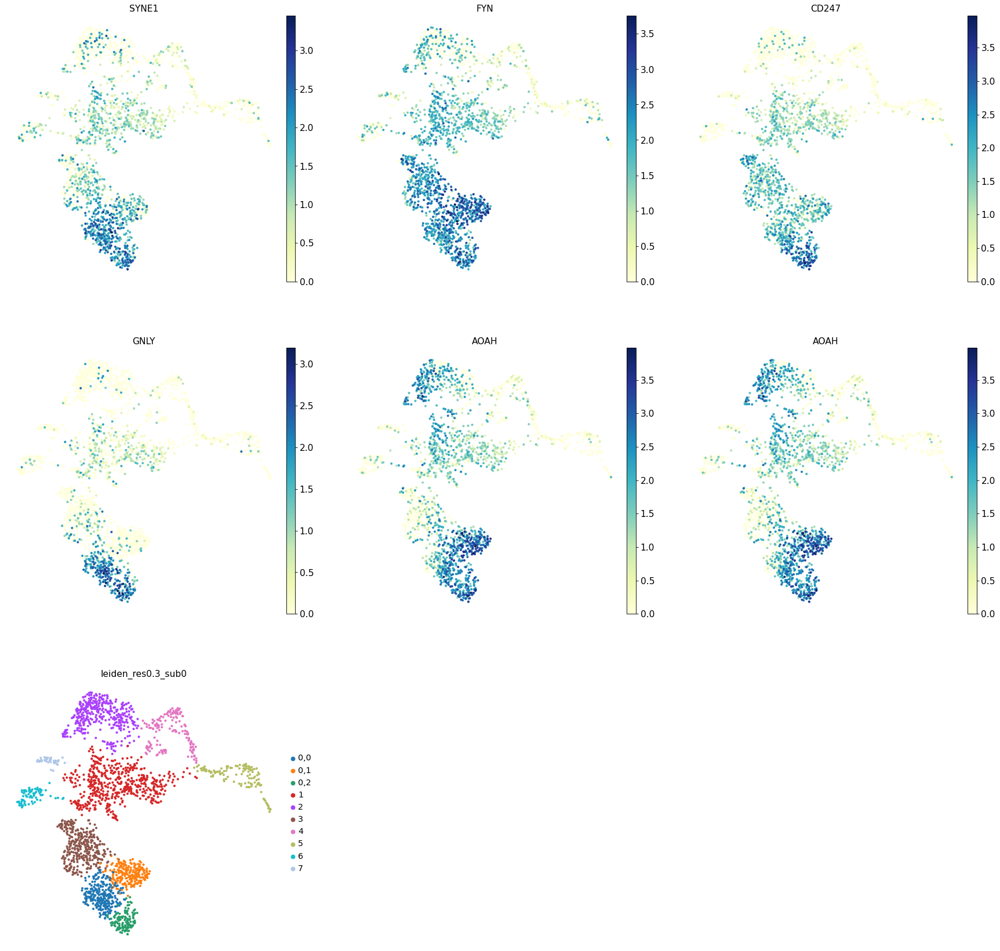

In [167]:
top_2_genes = list(adata_gex.uns[new_rg_key]['names'][0])+list(adata_gex.uns[new_rg_key]['names'][1])
sc.pl.umap(adata_gex, color=top_2_genes+[new_key], ncols=3)

In [168]:
marker_genes.keys()

dict_keys(['CD14+ Mono', 'CD16+ Mono', 'ID2-hi myeloid prog', 'cDC2', 'Reticulocyte', 'Erythroblast', 'Proerythroblast', 'NK', 'ILC', 'Lymph prog', 'Naive CD20+ B', 'B1 B', 'Transitional B', 'Plasma cells', 'CD4+ T activated', 'CD4+ T naive', 'CD8+ T', 'pDCs', 'G/M prog', 'HSC', 'MK/E prog'])

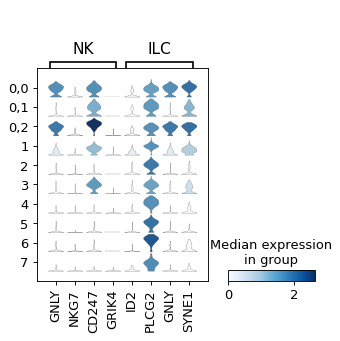

In [169]:
sc.pl.stacked_violin(adata_gex, var_names={a:marker_genes[a] for a in ['NK', 'ILC']}, groupby=new_key)

### Summary - cluster 0

- 0,0: NK
- 0,1: ILC
- 0,2: NK

## Cluster 1

In [170]:
orig_key = 'leiden_res0.3_sub0'
new_key = 'leiden_res0.3_sub1'
new_rg_key = 'rg_res0.3_sub1'
sub_key = '1'

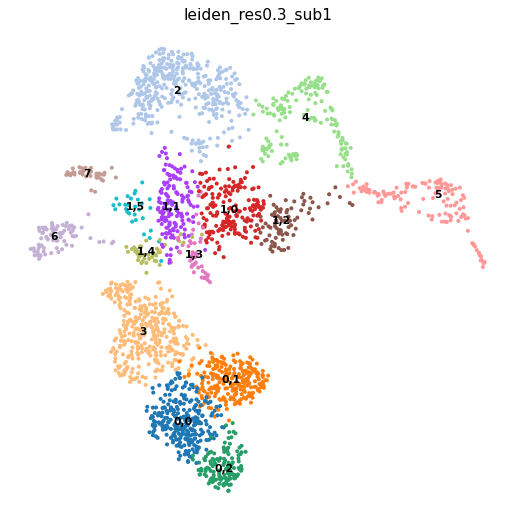

2      370
3      347
0,0    272
0,1    228
1,0    177
4      158
1,1    142
5      132
0,2    128
1,2     83
6       77
1,3     45
1,4     43
7       40
1,5     30
Name: leiden_res0.3_sub1, dtype: int64

In [171]:
res = 0.5
sc.tl.leiden(adata_gex, restrict_to=('leiden_res0.3_sub0', [sub_key]), key_added=new_key, resolution=res)
sc.pl.umap(adata_gex, color=new_key, legend_loc='on data', legend_fontsize='x-small')
adata_gex.obs[new_key].value_counts()

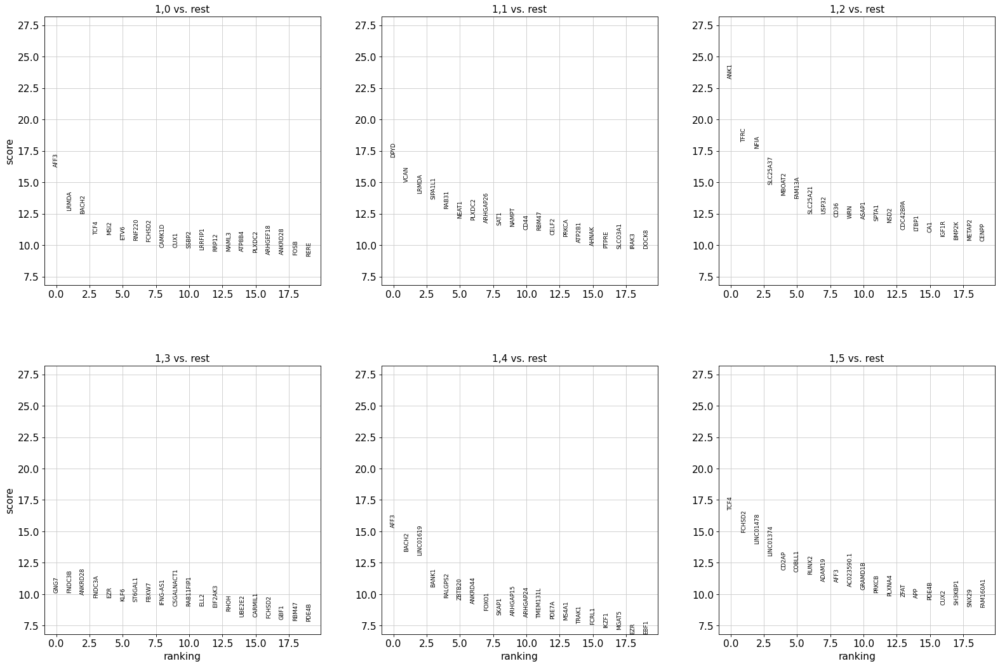

In [172]:
num_subclusts = 6
new_groups = [sub_key+','+str(i) for i in range(num_subclusts)]
sc.tl.rank_genes_groups(adata_gex, groupby=new_key, key_added=new_rg_key, groups=new_groups)
sc.pl.rank_genes_groups(adata_gex, key=new_rg_key, groups=new_groups, ncols=3)

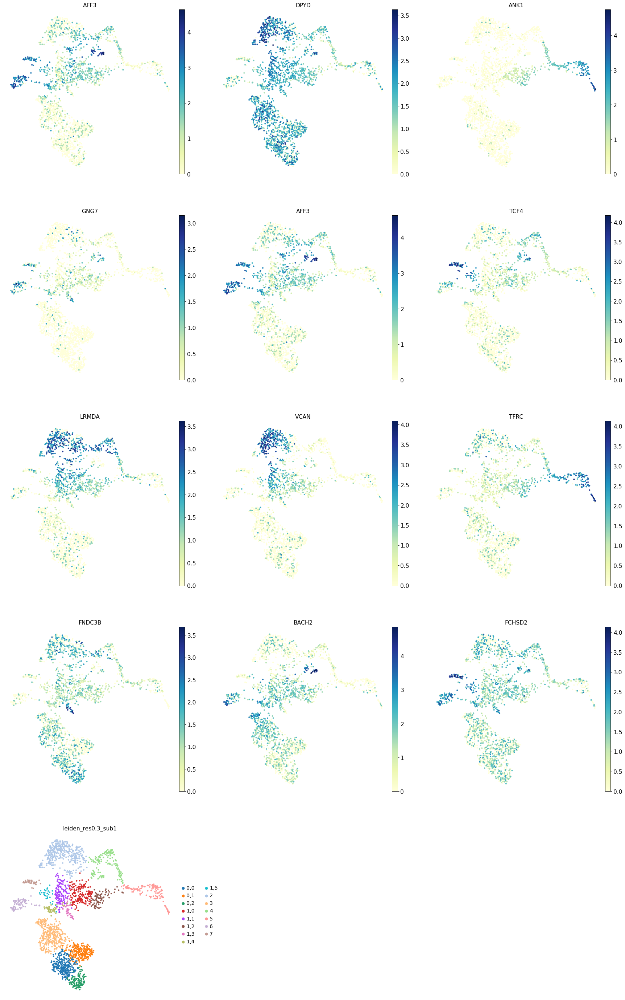

In [173]:
top_2_genes = list(adata_gex.uns[new_rg_key]['names'][0])+list(adata_gex.uns[new_rg_key]['names'][1])
sc.pl.umap(adata_gex, color=top_2_genes+[new_key], ncols=3)

In [174]:
marker_genes.keys()

dict_keys(['CD14+ Mono', 'CD16+ Mono', 'ID2-hi myeloid prog', 'cDC2', 'Reticulocyte', 'Erythroblast', 'Proerythroblast', 'NK', 'ILC', 'Lymph prog', 'Naive CD20+ B', 'B1 B', 'Transitional B', 'Plasma cells', 'CD4+ T activated', 'CD4+ T naive', 'CD8+ T', 'pDCs', 'G/M prog', 'HSC', 'MK/E prog'])

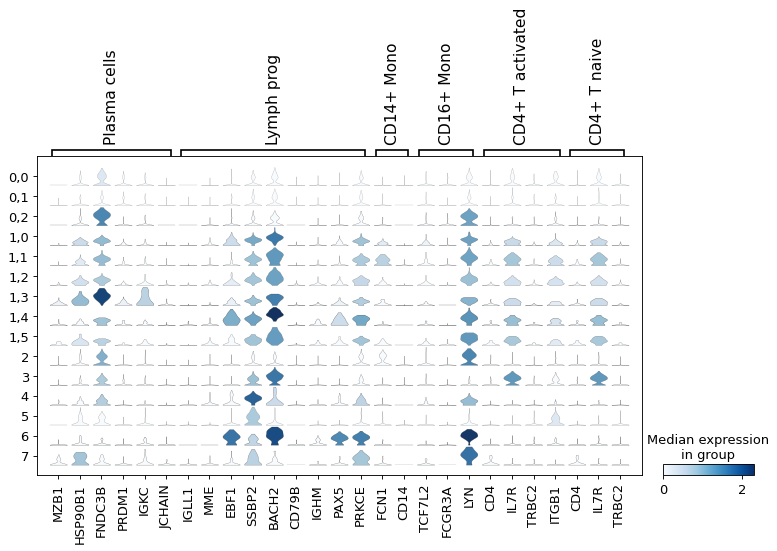

In [175]:
sc.pl.stacked_violin(adata_gex, var_names={a:marker_genes[a] for a in ['Plasma cells', 'Lymph prog', 'CD14+ Mono', 
                                                                       'CD16+ Mono', 'CD4+ T activated', 'CD4+ T naive']}, groupby=new_key)

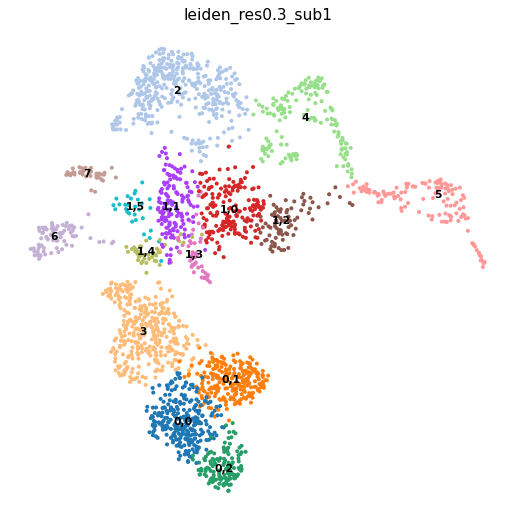

In [176]:
sc.pl.umap(adata_gex, color=new_key, legend_loc='on data', legend_fontsize='x-small')

### Summary - cluster 1

- 1,0: doublet
- 1,1: doublet
- 1,2: doublet
- 1,3: plasma cells
- 1,4: doublet (higher lymph prog signal in cluster 4)
- 1,5: doublet

## Cluster 2

In [177]:
orig_key = 'leiden_res0.3_sub1'
new_key = 'leiden_res0.3_sub2'
new_rg_key = 'rg_res0.3_sub2'
sub_key = '2'

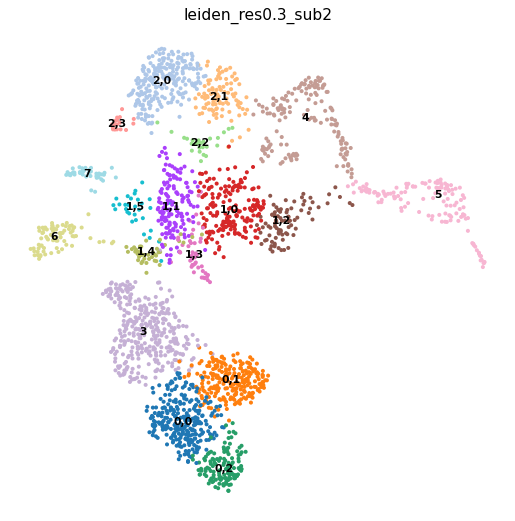

3      347
0,0    272
0,1    228
2,0    225
1,0    177
4      158
1,1    142
5      132
0,2    128
2,1    100
1,2     83
6       77
1,3     45
1,4     43
7       40
1,5     30
2,2     27
2,3     18
Name: leiden_res0.3_sub2, dtype: int64

In [178]:
res = 0.4
sc.tl.leiden(adata_gex, restrict_to=('leiden_res0.3_sub1', [sub_key]), key_added=new_key, resolution=res)
sc.pl.umap(adata_gex, color=new_key, legend_loc='on data', legend_fontsize='x-small')
adata_gex.obs[new_key].value_counts()

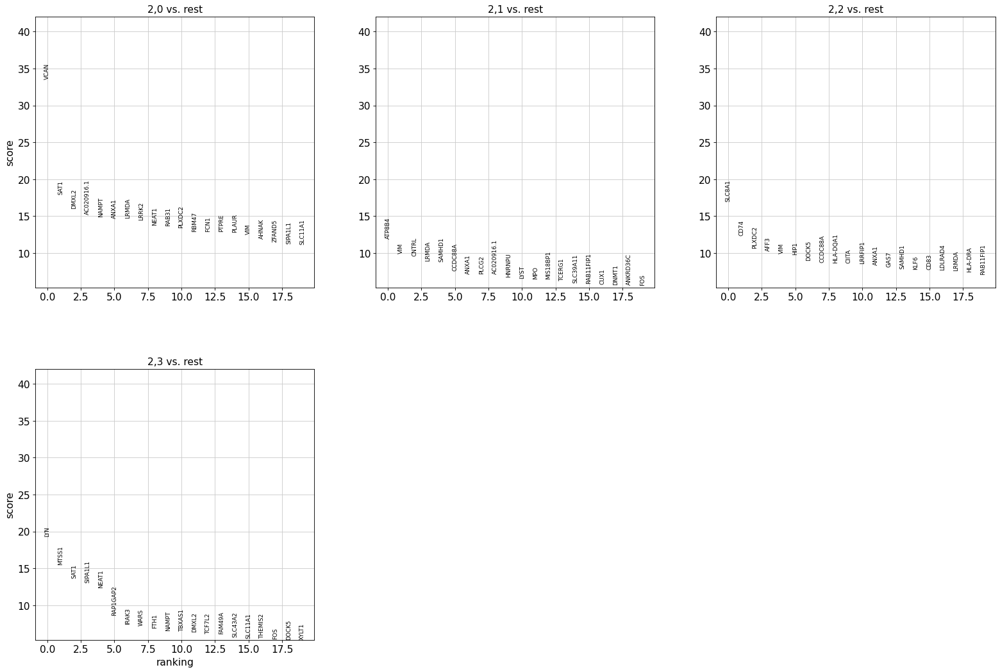

In [179]:
num_subclusts = 4
new_groups = [sub_key+','+str(i) for i in range(num_subclusts)]
sc.tl.rank_genes_groups(adata_gex, groupby=new_key, key_added=new_rg_key, groups=new_groups)
sc.pl.rank_genes_groups(adata_gex, key=new_rg_key, groups=new_groups, ncols=3)

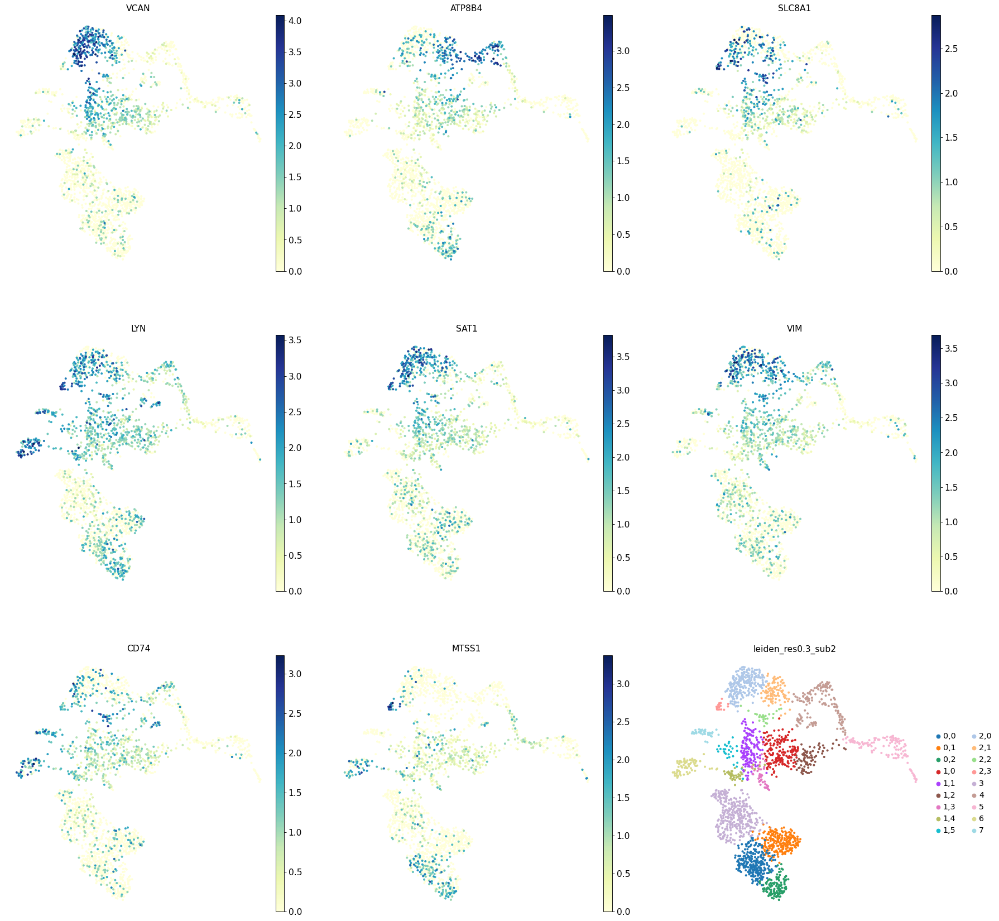

In [180]:
top_2_genes = list(adata_gex.uns[new_rg_key]['names'][0])+list(adata_gex.uns[new_rg_key]['names'][1])
sc.pl.umap(adata_gex, color=top_2_genes+[new_key], ncols=3)

In [181]:
marker_genes.keys()

dict_keys(['CD14+ Mono', 'CD16+ Mono', 'ID2-hi myeloid prog', 'cDC2', 'Reticulocyte', 'Erythroblast', 'Proerythroblast', 'NK', 'ILC', 'Lymph prog', 'Naive CD20+ B', 'B1 B', 'Transitional B', 'Plasma cells', 'CD4+ T activated', 'CD4+ T naive', 'CD8+ T', 'pDCs', 'G/M prog', 'HSC', 'MK/E prog'])

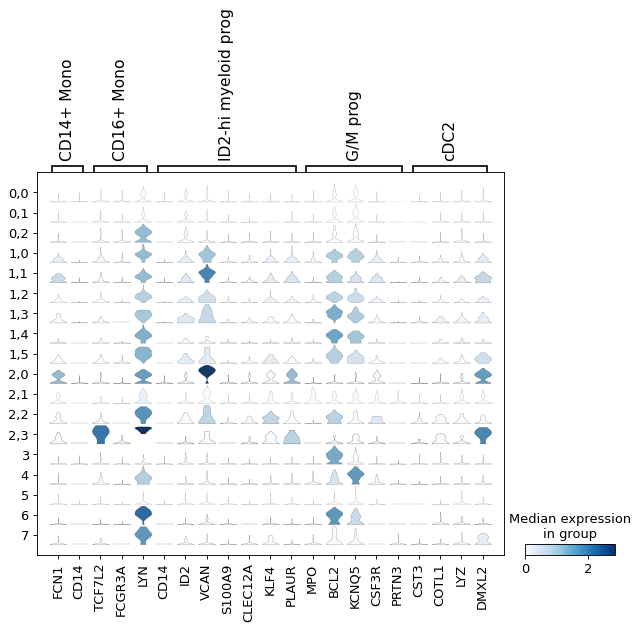

In [186]:
sc.pl.stacked_violin(adata_gex, var_names={a:marker_genes[a] for a in ['CD14+ Mono', 'CD16+ Mono', 'ID2-hi myeloid prog', 
                                                                       'G/M prog', 'cDC2']}, groupby=new_key)

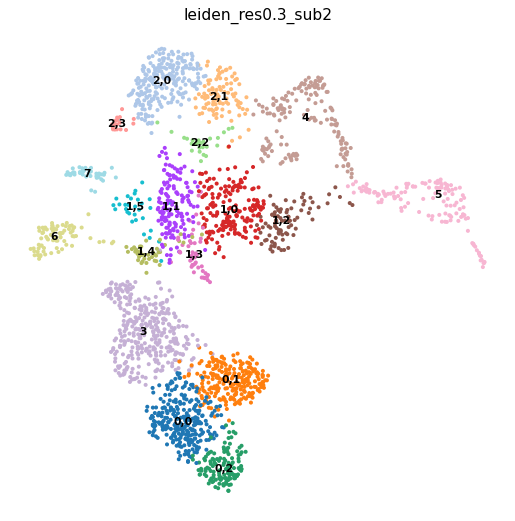

In [187]:
sc.pl.umap(adata_gex, color=new_key, legend_loc='on data', legend_fontsize='x-small')

### Summary - Cluster 2

- 2,0: CD14+ Mono
- 2,1: HSPC/Mono prog
- 2,2: ID2-hi myeloid prog
- 2,3: CD16+ Mono

## Cluster 3

In [188]:
orig_key = 'leiden_res0.3_sub2'
new_key = 'leiden_res0.3_sub3'
new_rg_key = 'rg_res0.3_sub3'
sub_key = '3'

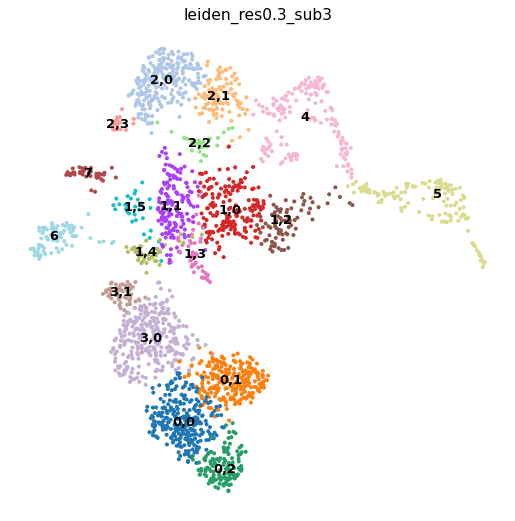

3,0    288
0,0    272
0,1    228
2,0    225
1,0    177
4      158
1,1    142
5      132
0,2    128
2,1    100
1,2     83
6       77
3,1     59
1,3     45
1,4     43
7       40
1,5     30
2,2     27
2,3     18
Name: leiden_res0.3_sub3, dtype: int64

In [189]:
res = 0.25
sc.tl.leiden(adata_gex, restrict_to=(orig_key, [sub_key]), key_added=new_key, resolution=res)
sc.pl.umap(adata_gex, color=new_key, legend_loc='on data', legend_fontsize = 'small')
adata_gex.obs[new_key].value_counts()

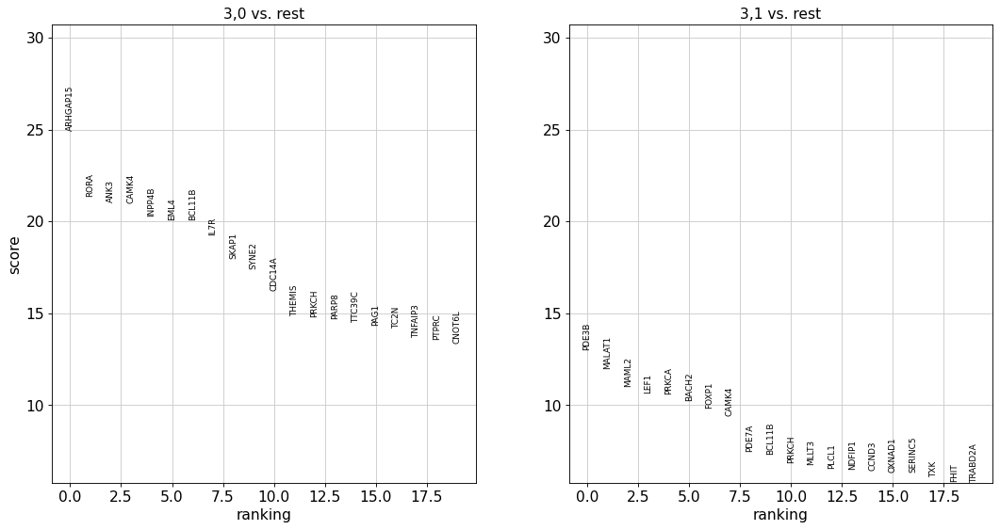

In [190]:
num_subclusts = 2
new_groups = [sub_key+','+str(i) for i in range(num_subclusts)]
sc.tl.rank_genes_groups(adata_gex, groupby=new_key, key_added=new_rg_key, groups=new_groups)
sc.pl.rank_genes_groups(adata_gex, key=new_rg_key, groups=new_groups, ncols=3)

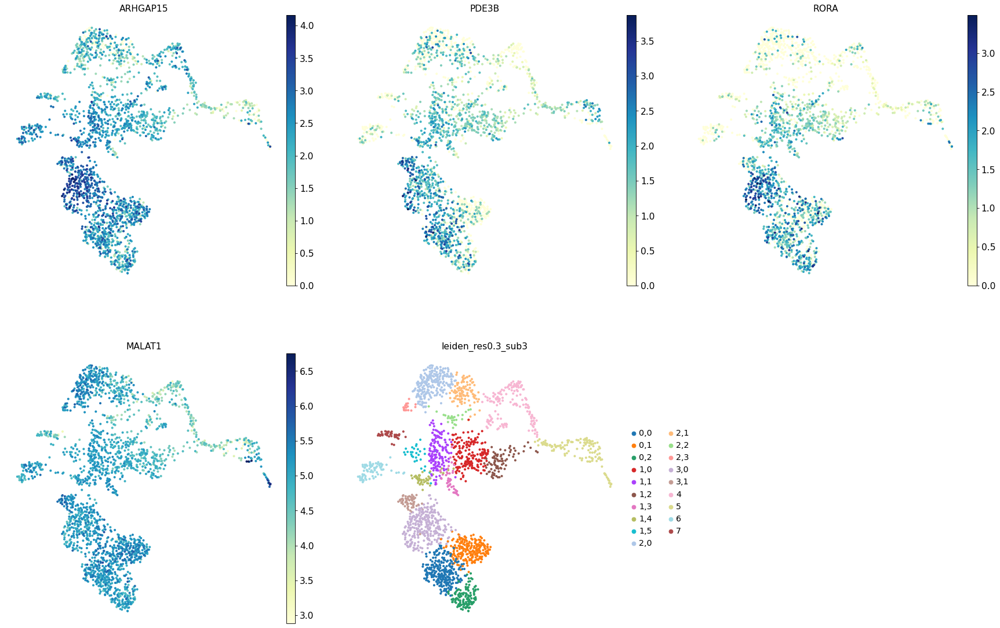

In [191]:
top_2_genes = list(adata_gex.uns[new_rg_key]['names'][0])+list(adata_gex.uns[new_rg_key]['names'][1])
sc.pl.umap(adata_gex, color=top_2_genes+[new_key], ncols=3)

In [192]:
marker_genes.keys()

dict_keys(['CD14+ Mono', 'CD16+ Mono', 'ID2-hi myeloid prog', 'cDC2', 'Reticulocyte', 'Erythroblast', 'Proerythroblast', 'NK', 'ILC', 'Lymph prog', 'Naive CD20+ B', 'B1 B', 'Transitional B', 'Plasma cells', 'CD4+ T activated', 'CD4+ T naive', 'CD8+ T', 'pDCs', 'G/M prog', 'HSC', 'MK/E prog'])

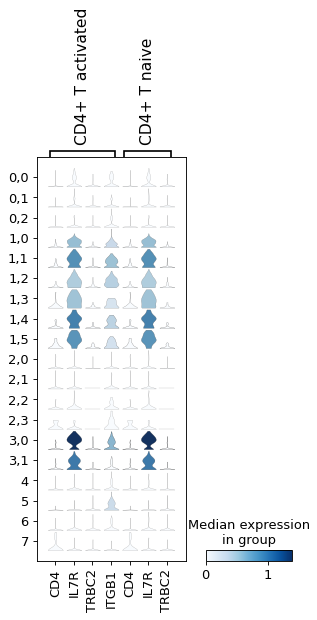

In [194]:
sc.pl.stacked_violin(adata_gex, var_names={a:marker_genes[a] for a in ['CD4+ T activated', 'CD4+ T naive']}, groupby=new_key)

### Summary - cluster 3

- 3,0: CD4+ T activated
- 3,1: CD4+ T naive

## Cluster 4

In [195]:
orig_key = 'leiden_res0.3_sub3'
new_key = 'leiden_res0.3_sub4'
new_rg_key = 'rg_res0.3_sub4'
sub_key = '4'

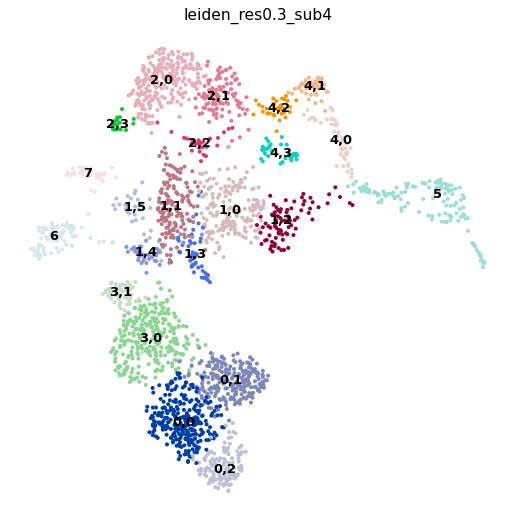

3,0    288
0,0    272
0,1    228
2,0    225
1,0    177
1,1    142
5      132
0,2    128
2,1    100
1,2     83
6       77
3,1     59
4,0     49
1,3     45
1,4     43
4,1     41
7       40
4,2     34
4,3     34
1,5     30
2,2     27
2,3     18
Name: leiden_res0.3_sub4, dtype: int64

In [196]:
res = 0.3
sc.tl.leiden(adata_gex, restrict_to=(orig_key, [sub_key]), key_added=new_key, resolution=res)
sc.pl.umap(adata_gex, color=new_key, legend_loc='on data', legend_fontsize = 'small')
adata_gex.obs[new_key].value_counts()

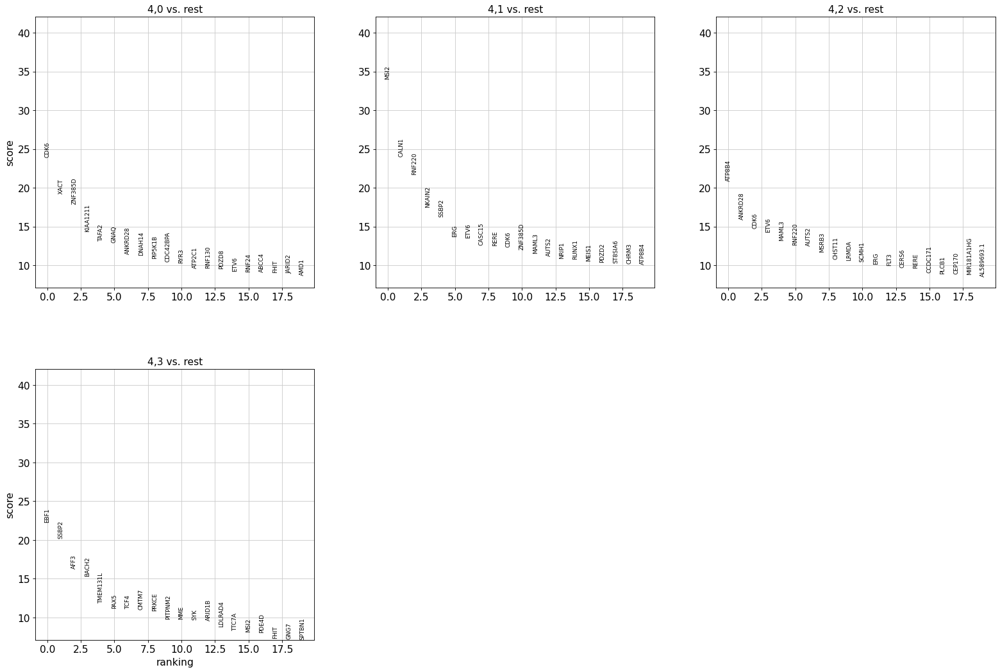

In [197]:
num_subclusts = 4
new_groups = [sub_key+','+str(i) for i in range(num_subclusts)]
sc.tl.rank_genes_groups(adata_gex, groupby=new_key, key_added=new_rg_key, groups=new_groups)
sc.pl.rank_genes_groups(adata_gex, key=new_rg_key, groups=new_groups, ncols=3)

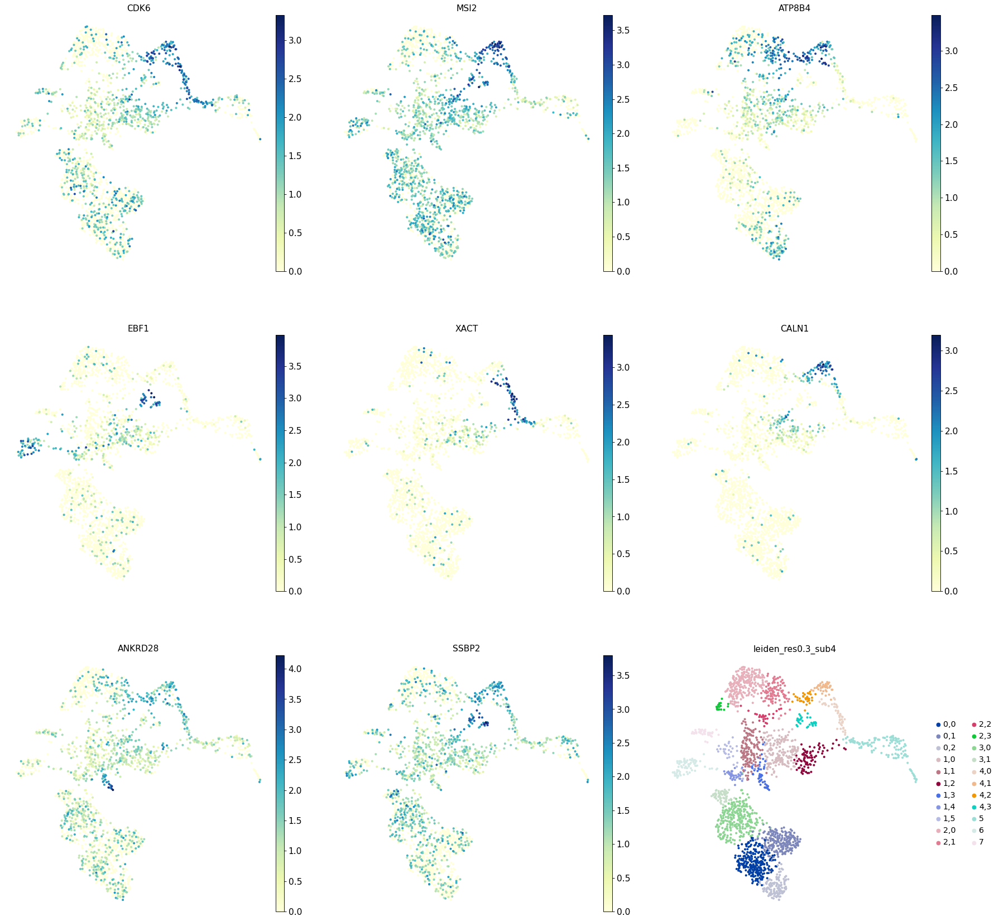

In [198]:
top_2_genes = list(adata_gex.uns[new_rg_key]['names'][0])+list(adata_gex.uns[new_rg_key]['names'][1])
sc.pl.umap(adata_gex, color=top_2_genes+[new_key], ncols=3)

In [199]:
marker_genes.keys()

dict_keys(['CD14+ Mono', 'CD16+ Mono', 'ID2-hi myeloid prog', 'cDC2', 'Reticulocyte', 'Erythroblast', 'Proerythroblast', 'NK', 'ILC', 'Lymph prog', 'Naive CD20+ B', 'B1 B', 'Transitional B', 'Plasma cells', 'CD4+ T activated', 'CD4+ T naive', 'CD8+ T', 'pDCs', 'G/M prog', 'HSC', 'MK/E prog'])

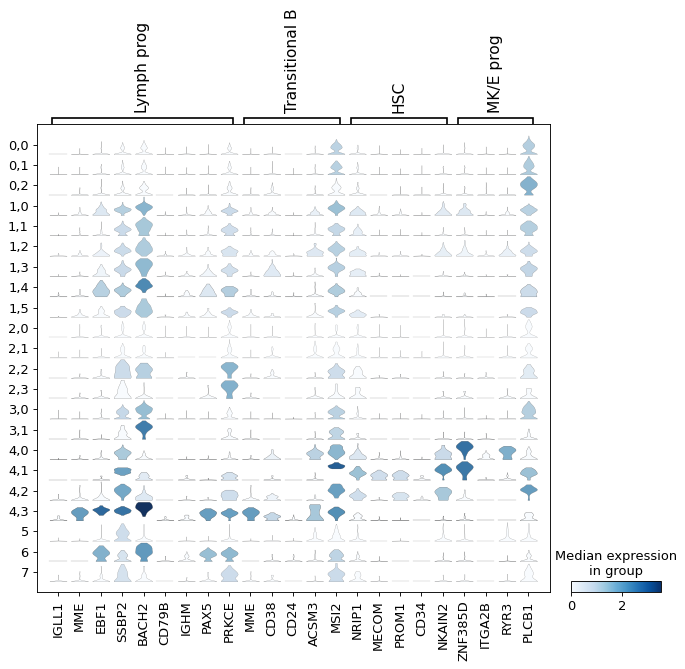

In [200]:
sc.pl.stacked_violin(adata_gex, var_names={a:marker_genes[a] for a in ['Lymph prog', 'Transitional B', 'HSC', 'MK/E prog']}, groupby=new_key)

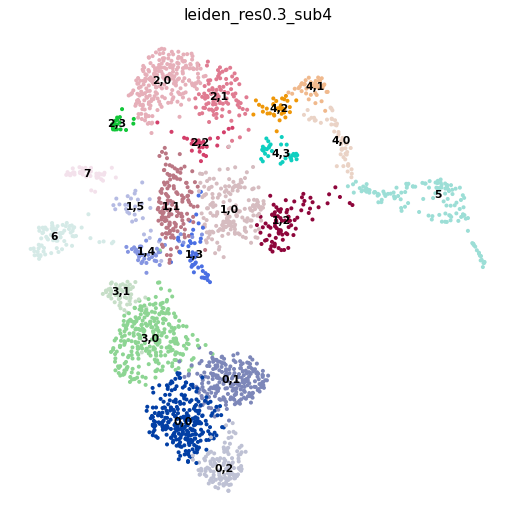

In [201]:
sc.pl.umap(adata_gex, color=new_key, legend_loc='on data', legend_fontsize = 'x-small')

### Summary - cluster 4

- 4,0: MK/E prog
- 4,1: HSC
- 4,2: Transitional B
- 4,3: Lymph prog

## Cluster 5

In [202]:
orig_key = 'leiden_res0.3_sub4'
new_key = 'leiden_res0.3_sub5'
new_rg_key = 'rg_res0.3_sub5'
sub_key = '5'

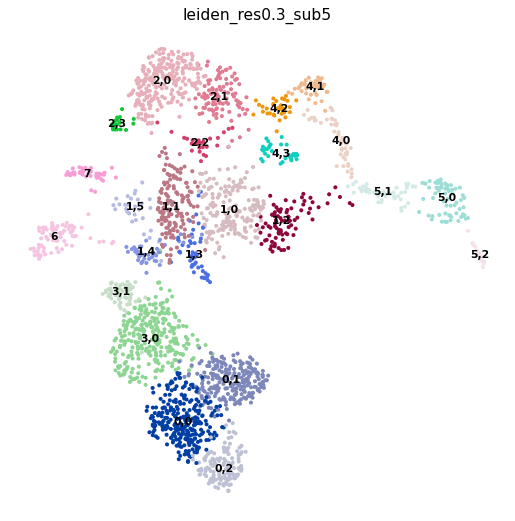

3,0    288
0,0    272
0,1    228
2,0    225
1,0    177
1,1    142
0,2    128
2,1    100
1,2     83
6       77
5,0     64
3,1     59
5,1     50
4,0     49
1,3     45
1,4     43
4,1     41
7       40
4,3     34
4,2     34
1,5     30
2,2     27
5,2     18
2,3     18
Name: leiden_res0.3_sub5, dtype: int64

In [203]:
res = 0.3
sc.tl.leiden(adata_gex, restrict_to=(orig_key, [sub_key]), key_added=new_key, resolution=res)
sc.pl.umap(adata_gex, color=new_key, legend_loc='on data', legend_fontsize = 'x-small')
adata_gex.obs[new_key].value_counts()

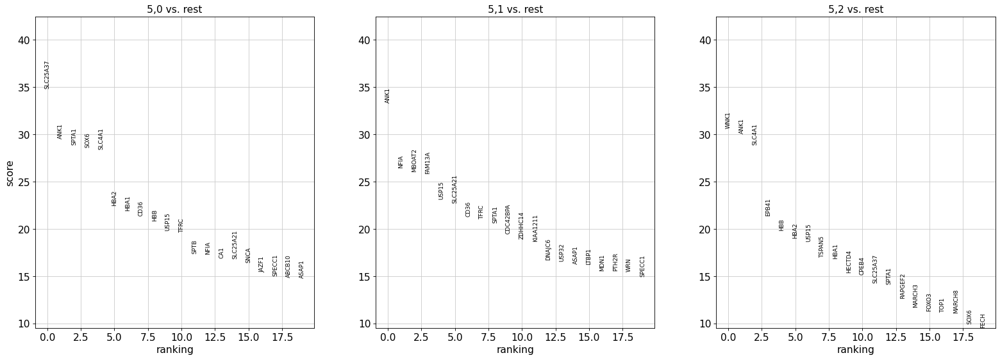

In [204]:
num_subclusts = 3
new_groups = [sub_key+','+str(i) for i in range(num_subclusts)]
sc.tl.rank_genes_groups(adata_gex, groupby=new_key, key_added=new_rg_key, groups=new_groups)
sc.pl.rank_genes_groups(adata_gex, key=new_rg_key, groups=new_groups, ncols=3)

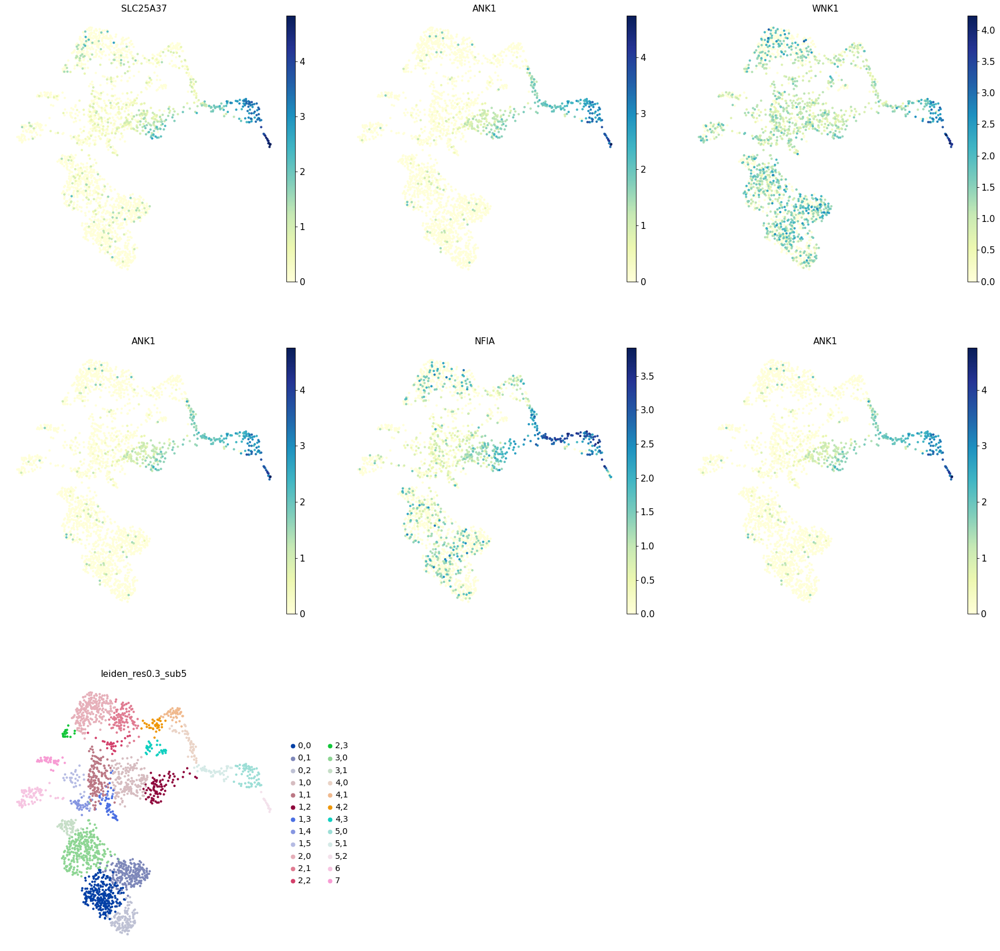

In [205]:
top_2_genes = list(adata_gex.uns[new_rg_key]['names'][0])+list(adata_gex.uns[new_rg_key]['names'][1])
sc.pl.umap(adata_gex, color=top_2_genes+[new_key], ncols=3)

In [206]:
marker_genes.keys()

dict_keys(['CD14+ Mono', 'CD16+ Mono', 'ID2-hi myeloid prog', 'cDC2', 'Reticulocyte', 'Erythroblast', 'Proerythroblast', 'NK', 'ILC', 'Lymph prog', 'Naive CD20+ B', 'B1 B', 'Transitional B', 'Plasma cells', 'CD4+ T activated', 'CD4+ T naive', 'CD8+ T', 'pDCs', 'G/M prog', 'HSC', 'MK/E prog'])

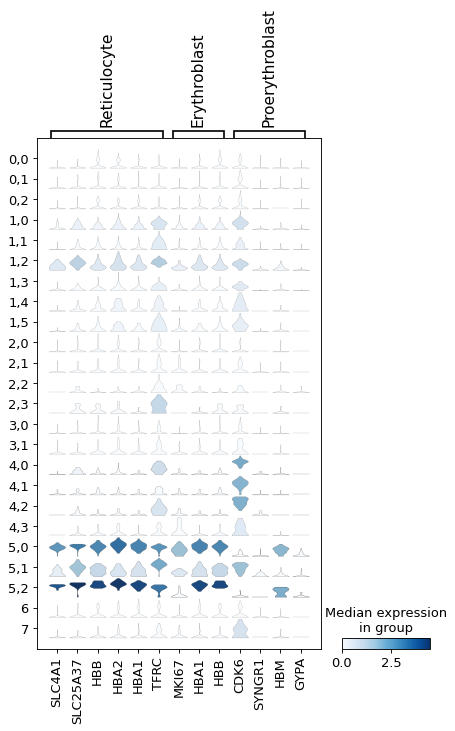

In [207]:
sc.pl.stacked_violin(adata_gex, var_names={a:marker_genes[a] for a in ['Reticulocyte', 'Erythroblast', 'Proerythroblast']}, groupby=new_key)

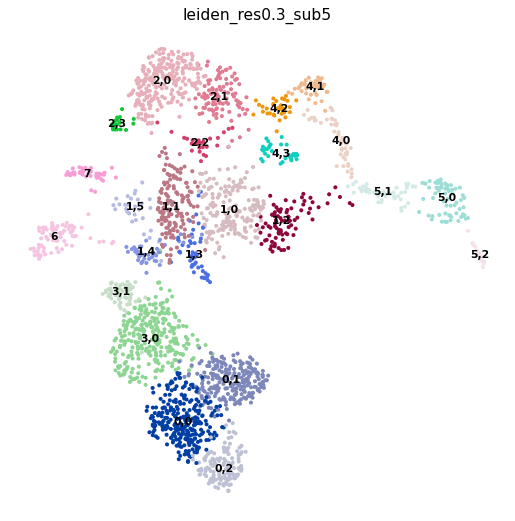

In [208]:
sc.pl.umap(adata_gex, color=new_key, legend_loc='on data', legend_fontsize = 'x-small')

### Summary - Cluster 5

- 5,0: erythroblast
- 5,1: proerythroblast
- 5,2: reticulocyte

## Cluster 6

In [209]:
orig_key = 'leiden_res0.3_sub5'
new_key = 'leiden_res0.3_sub6'
new_rg_key = 'rg_res0.3_sub6'
sub_key = '6'

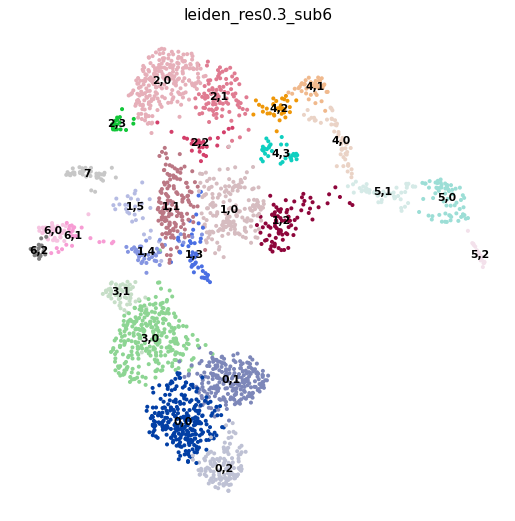

3,0    288
0,0    272
0,1    228
2,0    225
1,0    177
1,1    142
0,2    128
2,1    100
1,2     83
5,0     64
3,1     59
5,1     50
4,0     49
1,3     45
1,4     43
4,1     41
7       40
6,0     35
4,2     34
4,3     34
1,5     30
2,2     27
6,1     23
6,2     19
2,3     18
5,2     18
Name: leiden_res0.3_sub6, dtype: int64

In [210]:
res = 0.5
sc.tl.leiden(adata_gex, restrict_to=(orig_key, [sub_key]), key_added=new_key, resolution=res)
sc.pl.umap(adata_gex, color=new_key, legend_loc='on data', legend_fontsize = 'x-small')
adata_gex.obs[new_key].value_counts()

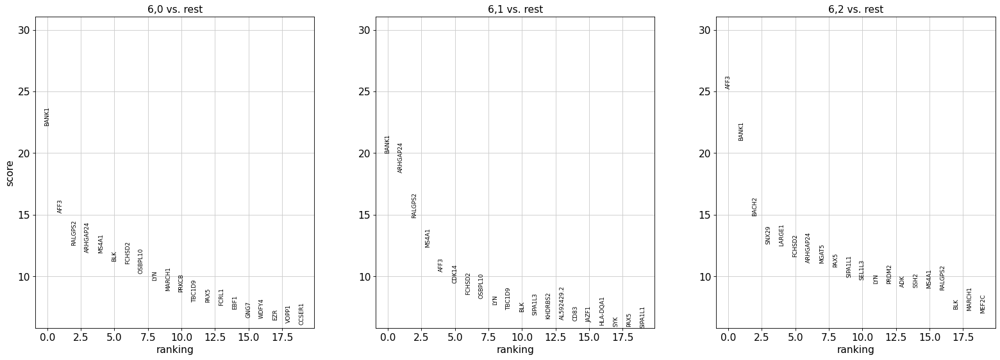

In [211]:
num_subclusts = 3
new_groups = [sub_key+','+str(i) for i in range(num_subclusts)]
sc.tl.rank_genes_groups(adata_gex, groupby=new_key, key_added=new_rg_key, groups=new_groups)
sc.pl.rank_genes_groups(adata_gex, key=new_rg_key, groups=new_groups, ncols=3)

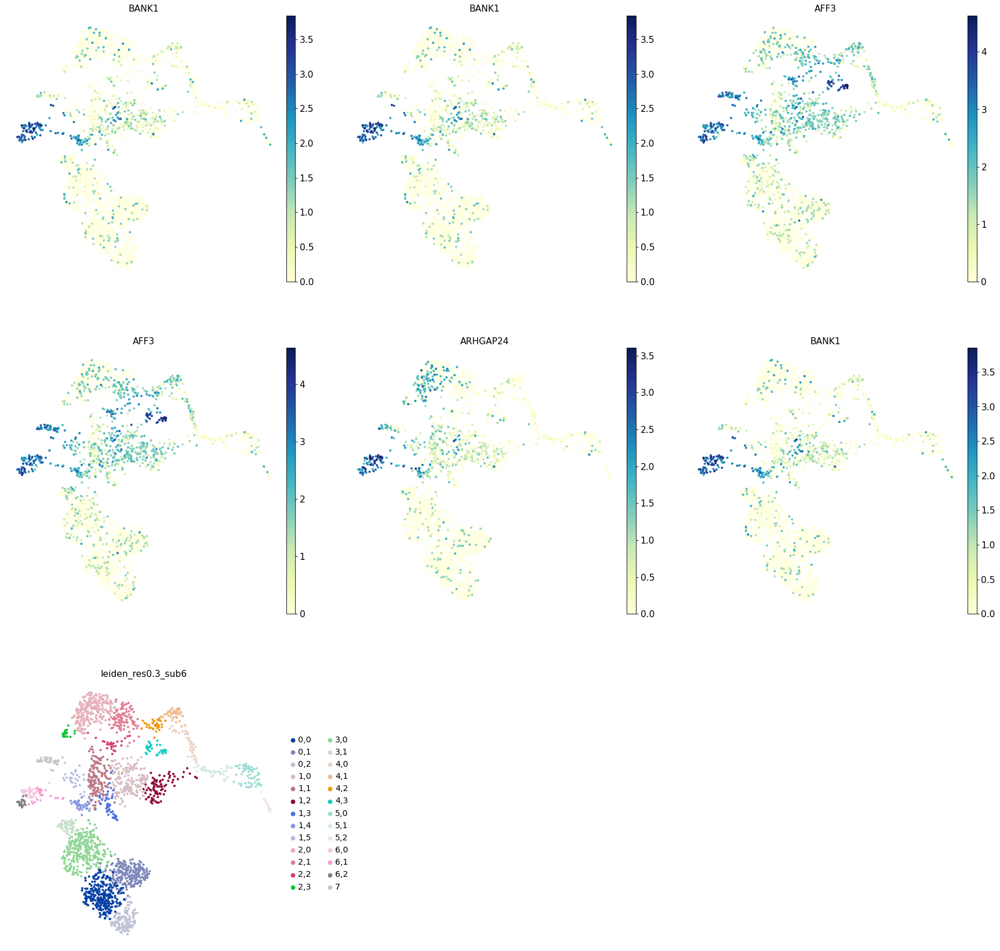

In [212]:
top_2_genes = list(adata_gex.uns[new_rg_key]['names'][0])+list(adata_gex.uns[new_rg_key]['names'][1])
sc.pl.umap(adata_gex, color=top_2_genes+[new_key], ncols=3)

In [213]:
marker_genes.keys()

dict_keys(['CD14+ Mono', 'CD16+ Mono', 'ID2-hi myeloid prog', 'cDC2', 'Reticulocyte', 'Erythroblast', 'Proerythroblast', 'NK', 'ILC', 'Lymph prog', 'Naive CD20+ B', 'B1 B', 'Transitional B', 'Plasma cells', 'CD4+ T activated', 'CD4+ T naive', 'CD8+ T', 'pDCs', 'G/M prog', 'HSC', 'MK/E prog'])

Not sure what cluster 3 is so look at other cell types where we expec to see larger populations

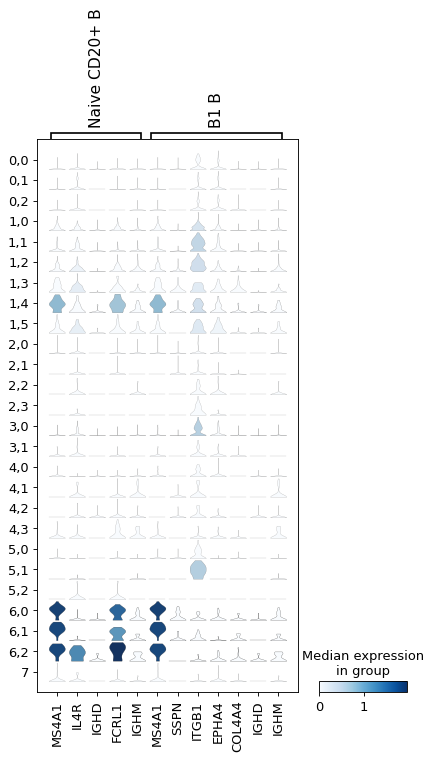

In [214]:
sc.pl.stacked_violin(adata_gex, var_names={a:marker_genes[a] for a in ['Naive CD20+ B', 'B1 B']}, groupby=new_key)

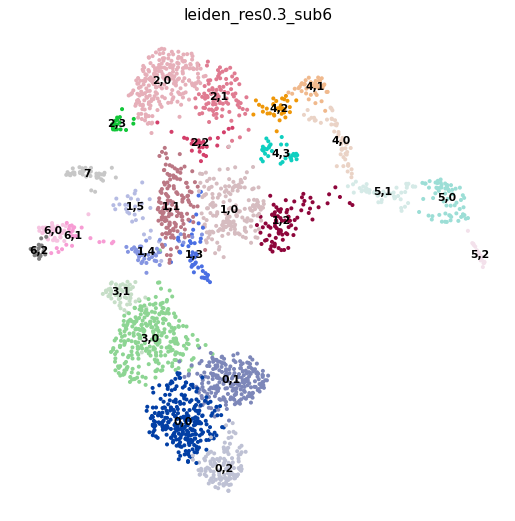

In [215]:
sc.pl.umap(adata_gex, color=new_key, legend_loc='on data', legend_fontsize = 'x-small')

### Summary - Cluster 6

- 6,0: Naive CD20+ B 
- 6,1: B1 B
- 6,2: Naive CD20+ B

## Cluster 7

In [216]:
orig_key = 'leiden_res0.3_sub6'
new_key = 'leiden_res0.3_sub7'
new_rg_key = 'rg_res0.3_sub7'
sub_key = '7'

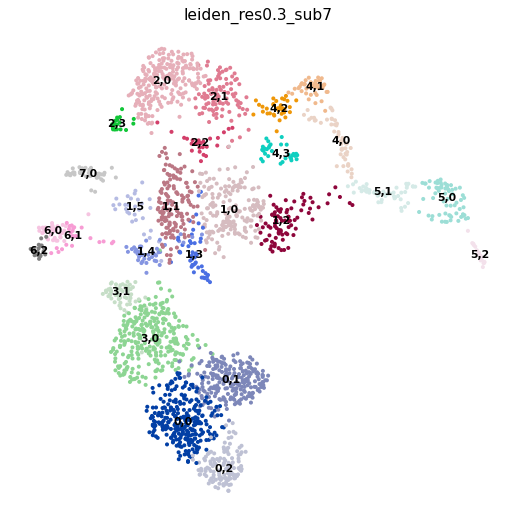

3,0    288
0,0    272
0,1    228
2,0    225
1,0    177
1,1    142
0,2    128
2,1    100
1,2     83
5,0     64
3,1     59
5,1     50
4,0     49
1,3     45
1,4     43
4,1     41
7,0     40
6,0     35
4,2     34
4,3     34
1,5     30
2,2     27
6,1     23
6,2     19
2,3     18
5,2     18
Name: leiden_res0.3_sub7, dtype: int64

In [217]:
res = 0.2
sc.tl.leiden(adata_gex, restrict_to=(orig_key, [sub_key]), key_added=new_key, resolution=res)
sc.pl.umap(adata_gex, color=new_key, legend_loc='on data', legend_fontsize = 'x-small')
adata_gex.obs[new_key].value_counts()

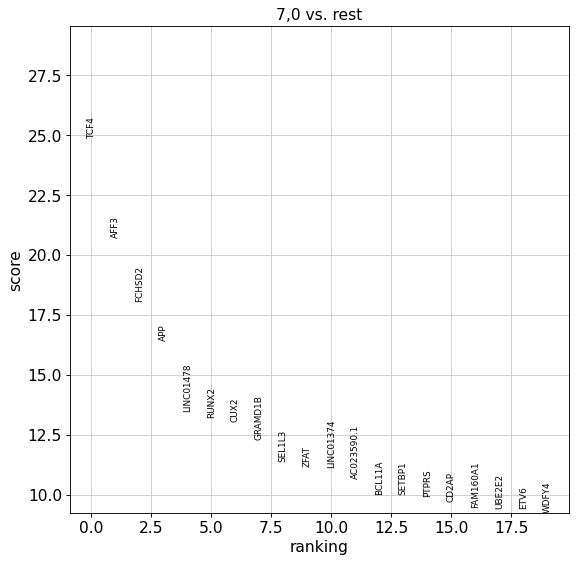

In [218]:
num_subclusts = 1
new_groups = [sub_key+','+str(i) for i in range(num_subclusts)]
sc.tl.rank_genes_groups(adata_gex, groupby=new_key, key_added=new_rg_key, groups=new_groups)
sc.pl.rank_genes_groups(adata_gex, key=new_rg_key, groups=new_groups, ncols=3)

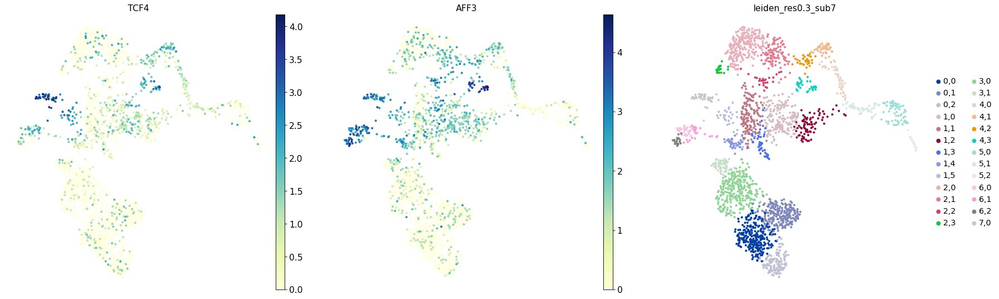

In [219]:
top_2_genes = list(adata_gex.uns[new_rg_key]['names'][0])+list(adata_gex.uns[new_rg_key]['names'][1])
sc.pl.umap(adata_gex, color=top_2_genes+[new_key], ncols=3)

In [220]:
marker_genes.keys()

dict_keys(['CD14+ Mono', 'CD16+ Mono', 'ID2-hi myeloid prog', 'cDC2', 'Reticulocyte', 'Erythroblast', 'Proerythroblast', 'NK', 'ILC', 'Lymph prog', 'Naive CD20+ B', 'B1 B', 'Transitional B', 'Plasma cells', 'CD4+ T activated', 'CD4+ T naive', 'CD8+ T', 'pDCs', 'G/M prog', 'HSC', 'MK/E prog'])

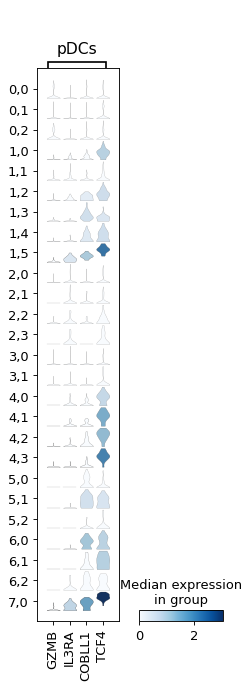

In [221]:
sc.pl.stacked_violin(adata_gex, var_names={a:marker_genes[a] for a in ['pDCs']}, groupby=new_key)

### Summary - Cluster 7

- 7,0: pDCs

## Identify doublet clusters

### 1. Doublet scores

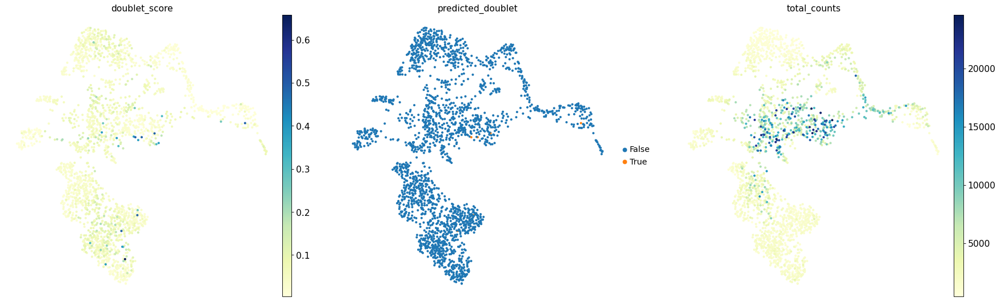

In [222]:
sc.pl.umap(adata_gex, color=['doublet_score', 'predicted_doublet', 'total_counts'])

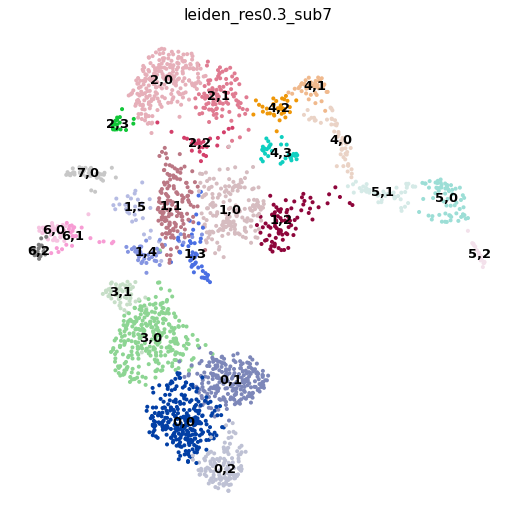

In [223]:
sc.pl.umap(adata_gex, color=['leiden_res0.3_sub7'], legend_loc='on data', legend_fontsize='small')

### 2. Doublet gene list

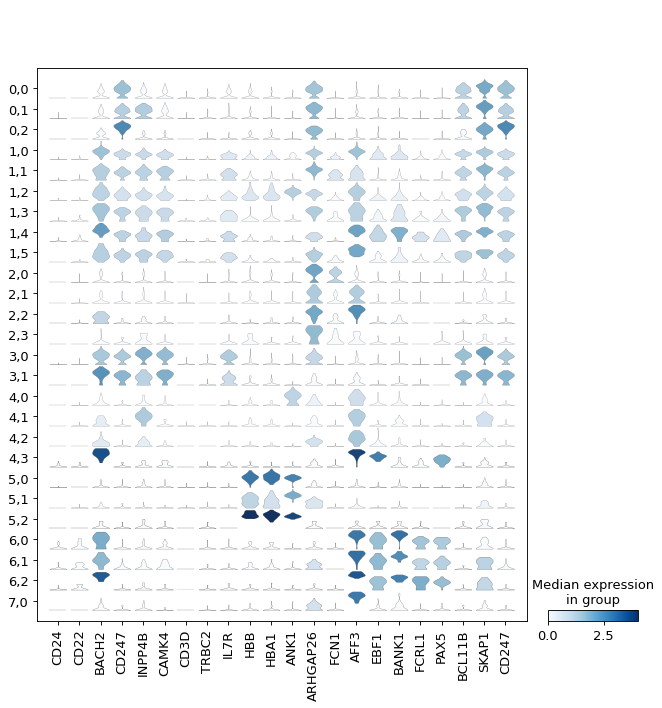

In [224]:
# Check the above markers again to make sure
sc.pl.stacked_violin(adata_gex, var_names=['CD24', 'CD22', 'BACH2', 'CD247', 'INPP4B', 'CAMK4', 'CD3D', 'TRBC2', 'IL7R', 
                                           'HBB', 'HBA1', 'ANK1', 'ARHGAP26', 'FCN1', 'AFF3', 'EBF1', 'BANK1', 'FCRL1', 'PAX5', 
                                           'BCL11B', 'SKAP1', 'CD247'], groupby='leiden_res0.3_sub7')

### 3. Check marker expression against other known clusters

Check cluster 1,4. Compare 1,4 in 4

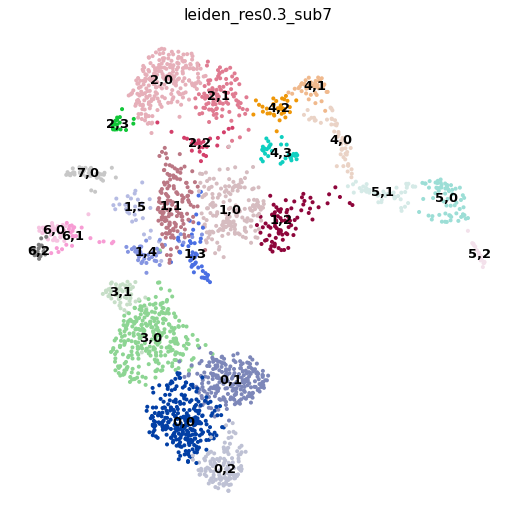

In [225]:
sc.pl.umap(adata_gex, color=['leiden_res0.3_sub7'], legend_loc='on data', legend_fontsize='small')

### Lymph prog doublets - cluster 1,4 check

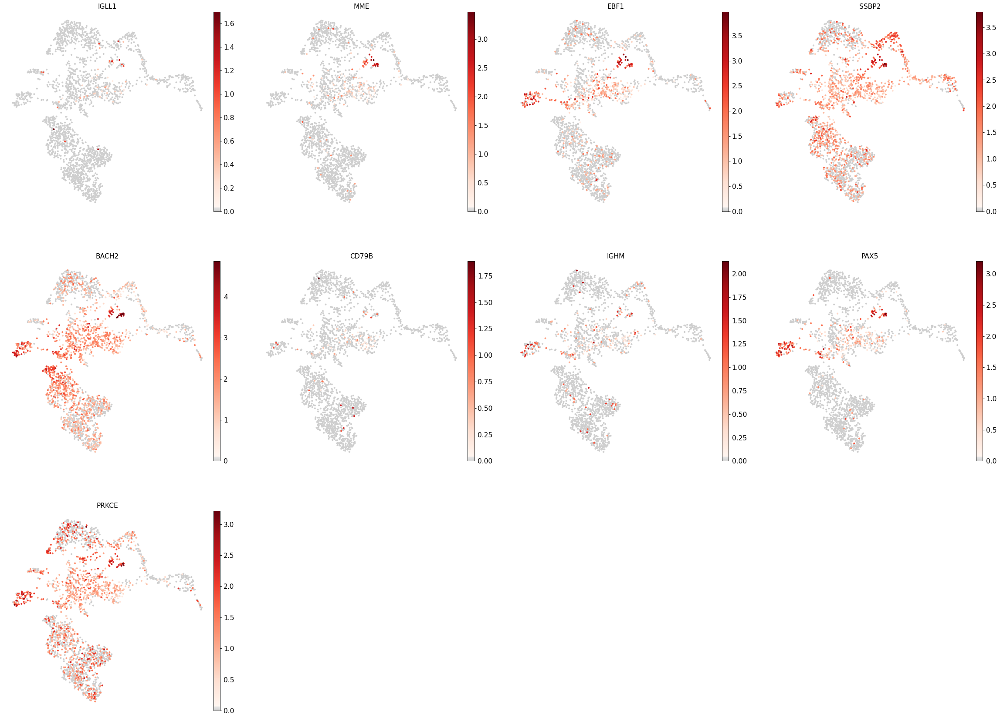

In [226]:
sc.pl.umap(adata_gex, color=marker_genes['Lymph prog'], use_raw=False, cmap=mymap)

- 1,4 lymph prog expression is lower. call 1,4 doublets

### Summary

All of cluster 1 (except 1,3) are doublets

=> Filter out all

# Cluster overview

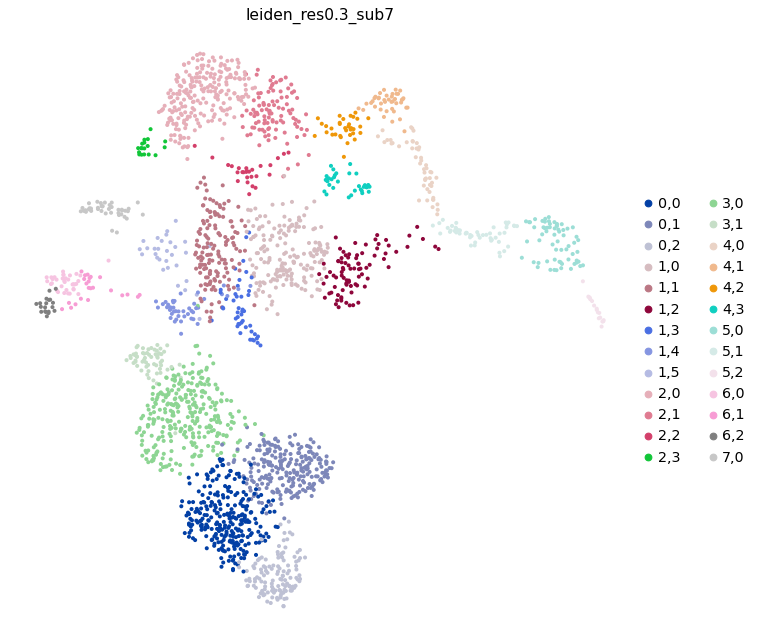

In [227]:
plt.rcParams['figure.figsize'] = (10,10)
sc.pl.umap(adata_gex, color='leiden_res0.3_sub7')
plt.rcParams['figure.figsize'] = (8,8)

## Doublet filtering

In [228]:
adata_gex.obs['leiden_res0.3_sub7'].value_counts()

3,0    288
0,0    272
0,1    228
2,0    225
1,0    177
1,1    142
0,2    128
2,1    100
1,2     83
5,0     64
3,1     59
5,1     50
4,0     49
1,3     45
1,4     43
4,1     41
7,0     40
6,0     35
4,2     34
4,3     34
1,5     30
2,2     27
6,1     23
6,2     19
2,3     18
5,2     18
Name: leiden_res0.3_sub7, dtype: int64

In [229]:
adata

AnnData object with n_obs × n_vars = 2355 × 194756
    obs: 'sample'
    var: 'gene_ids', 'feature_types', 'genome'

In [230]:
(177 + 142 + 83 + 43 + 30) / 2355

0.20169851380042464

Doublet clusters:
- 1,0: 177
- 1,1: 142
- 1,2: 83
- 1,4: 43
- 1,5: 30

=> total 475/2355 cells = 20.17% (pretty high)

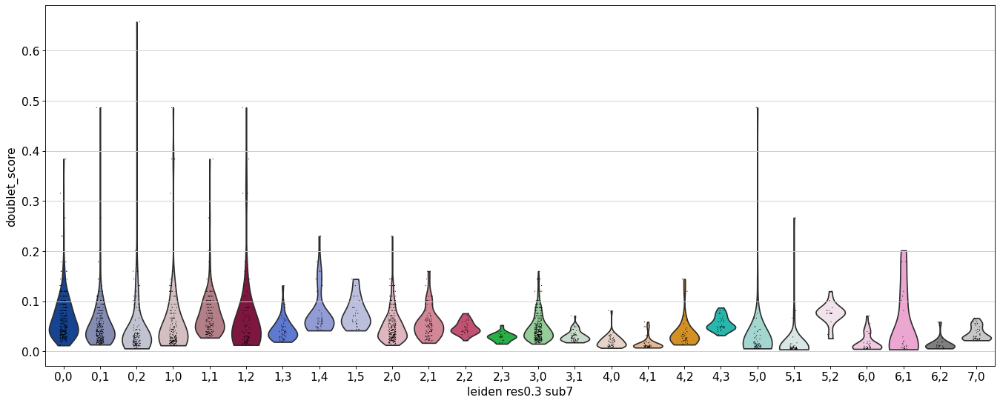

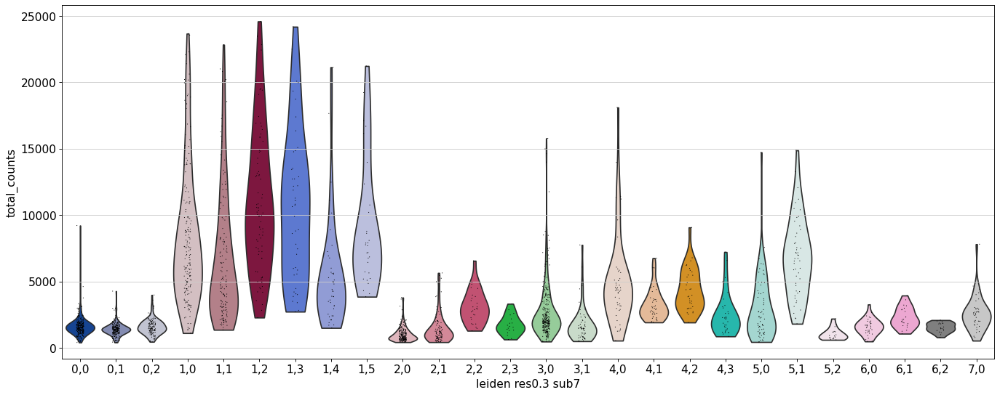

In [231]:
plt.rcParams['figure.figsize']=(16,8)
sc.pl.violin(adata_gex, keys='doublet_score', groupby='leiden_res0.3_sub7')
sc.pl.violin(adata_gex, keys='total_counts', groupby='leiden_res0.3_sub7')
plt.rcParams['figure.figsize']=(8,8)

Indeed the likely doublet clusters have broad expression of all markers, and don't express any marker more highly than any other cell cluster that is not designated as doublet.

In [232]:
adata_gex_filt = adata_gex[~adata_gex.obs['leiden_res0.3_sub7'].isin(['1,0', '1,1', '1,2', '1,4', '1,5'])].copy()

## Rename clusters

In [233]:
# Merge NK clusters
adata_gex_filt.obs['leiden_final'] = ['0,0 0,2' if c in ['0,0', '0,2'] else c for c in adata_gex_filt.obs['leiden_res0.3_sub7']]
adata_gex_filt.obs['leiden_final'] = adata_gex_filt.obs['leiden_final'].astype('category')
adata_gex_filt.obs['leiden_final'].cat.categories
adata_gex_filt.obs['leiden_final'].value_counts()

0,0 0,2    400
3,0        288
0,1        228
2,0        225
2,1        100
5,0         64
3,1         59
5,1         50
4,0         49
1,3         45
4,1         41
7,0         40
6,0         35
4,2         34
4,3         34
2,2         27
6,1         23
6,2         19
2,3         18
5,2         18
Name: leiden_final, dtype: int64

In [234]:
# Merge Naive CD20+ B subclusters 
adata_gex_filt.obs['leiden_final'] = ['6,0 6,2' if c in ['6,0', '6,2'] else c for c in adata_gex_filt.obs['leiden_final']]
adata_gex_filt.obs['leiden_final'] = adata_gex_filt.obs['leiden_final'].astype('category')
adata_gex_filt.obs['leiden_final'].cat.categories
adata_gex_filt.obs['leiden_final'].value_counts()

0,0 0,2    400
3,0        288
0,1        228
2,0        225
2,1        100
5,0         64
3,1         59
6,0 6,2     54
5,1         50
4,0         49
1,3         45
4,1         41
7,0         40
4,2         34
4,3         34
2,2         27
6,1         23
2,3         18
5,2         18
Name: leiden_final, dtype: int64

In [235]:
marker_genes.keys()

dict_keys(['CD14+ Mono', 'CD16+ Mono', 'ID2-hi myeloid prog', 'cDC2', 'Reticulocyte', 'Erythroblast', 'Proerythroblast', 'NK', 'ILC', 'Lymph prog', 'Naive CD20+ B', 'B1 B', 'Transitional B', 'Plasma cells', 'CD4+ T activated', 'CD4+ T naive', 'CD8+ T', 'pDCs', 'G/M prog', 'HSC', 'MK/E prog'])

In [238]:
rename_clust_dict = {
    '0,0 0,2':'NK',
    '3,0': 'CD4+ T activated', 
    '0,1': 'ILC',
    '2,0': 'CD14+ Mono',
    '2,1': 'G/M prog', 
    '5,0': 'Erythroblast',
    '3,1': 'CD4+ T naive',
    '6,0 6,2': 'Naive CD20+ B',
    '5,1': 'Proerythroblast',
    '4,0': 'MK/E prog',
    '1,3': 'Plasma cells',
    '4,1': 'HSC',
    '7,0': 'pDCs',
    '4,2': 'Transitional B',
    '4,3': 'Lymph prog',
    '2,2': 'ID2-hi myeloid prog',
    '6,1': 'B1 B',
    '2,3': 'CD16+ Mono',
    '5,2': 'Reticulocyte'
}

In [239]:
# Note: this must be done in the same order as the categories above!
adata_gex_filt.rename_categories('leiden_final', [rename_clust_dict[ct] for ct in adata_gex_filt.obs['leiden_final'].cat.categories])

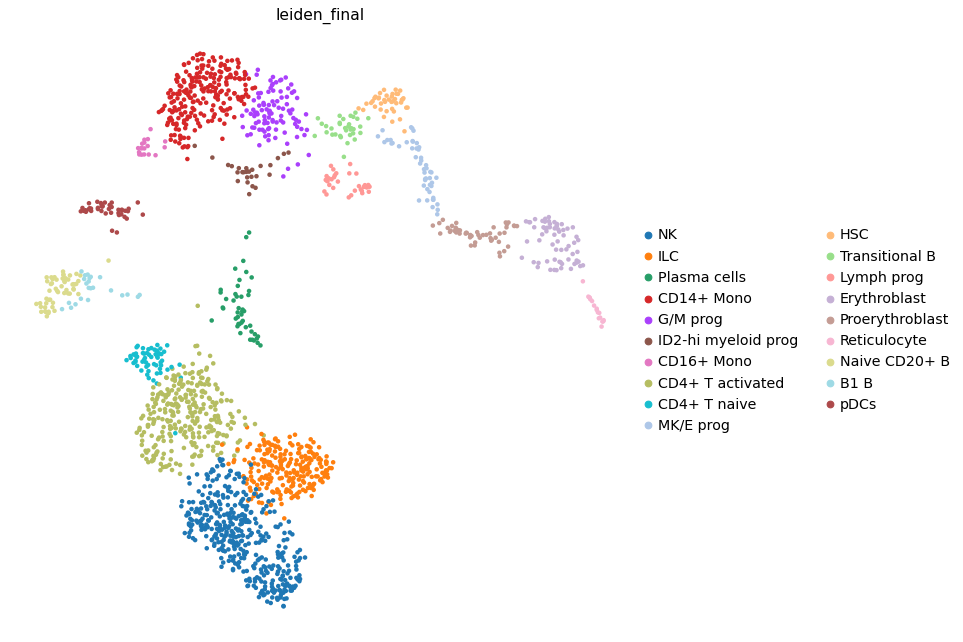

In [240]:
plt.rcParams['figure.figsize'] = (10,10)
sc.pl.umap(adata_gex_filt, color='leiden_final')
plt.rcParams['figure.figsize'] = (8,8)

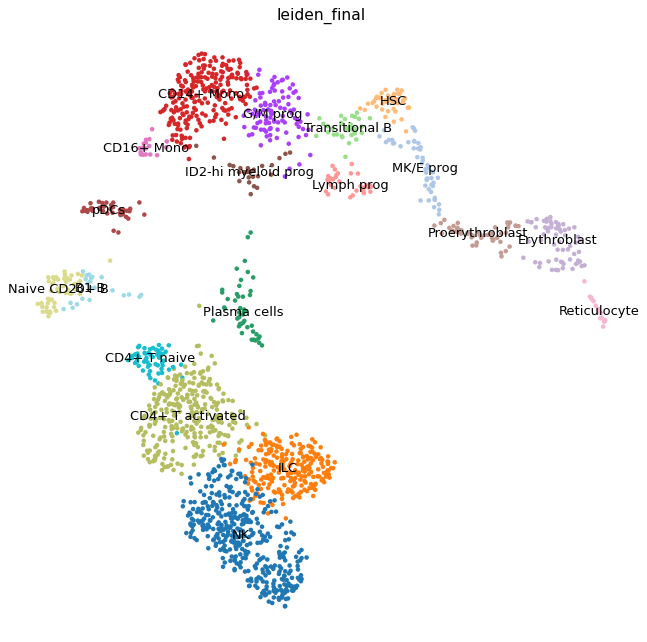

In [241]:
plt.rcParams['figure.figsize'] = (10,10)
sc.pl.umap(adata_gex_filt, color='leiden_final', legend_loc='on data', legend_fontsize='small', legend_fontweight='light')
plt.rcParams['figure.figsize'] = (8,8)

# Marker overview

In [242]:
marker_genes.keys()

dict_keys(['CD14+ Mono', 'CD16+ Mono', 'ID2-hi myeloid prog', 'cDC2', 'Reticulocyte', 'Erythroblast', 'Proerythroblast', 'NK', 'ILC', 'Lymph prog', 'Naive CD20+ B', 'B1 B', 'Transitional B', 'Plasma cells', 'CD4+ T activated', 'CD4+ T naive', 'CD8+ T', 'pDCs', 'G/M prog', 'HSC', 'MK/E prog'])

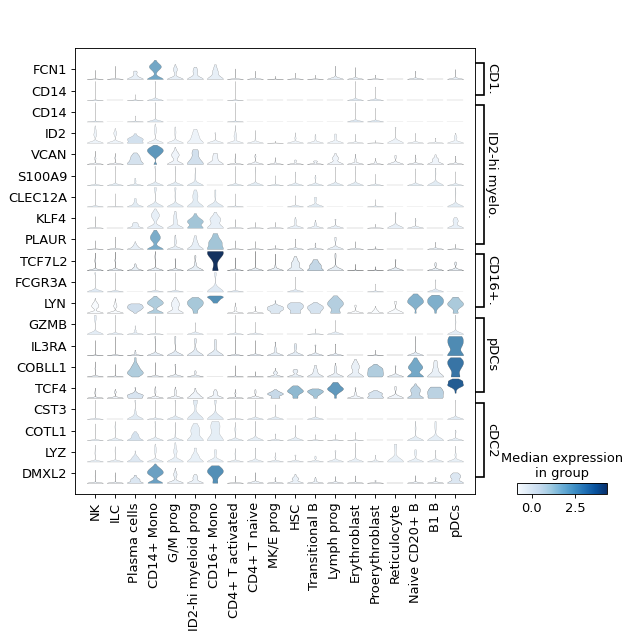

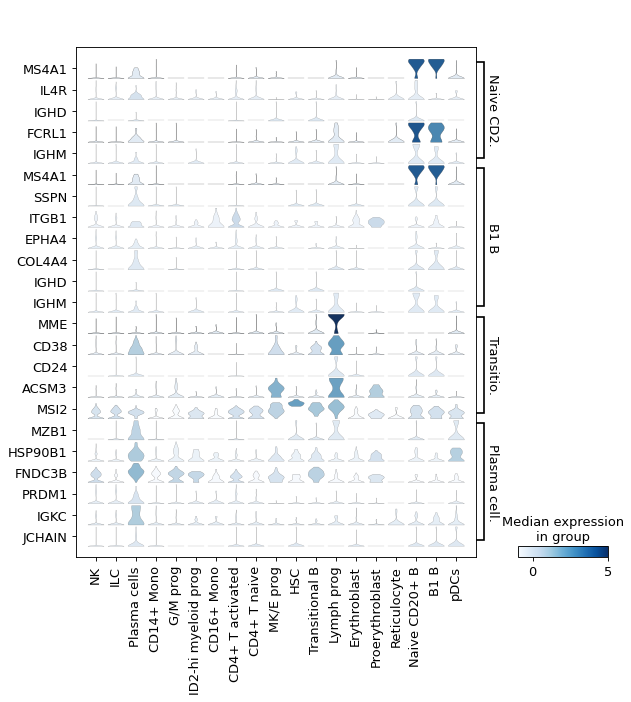

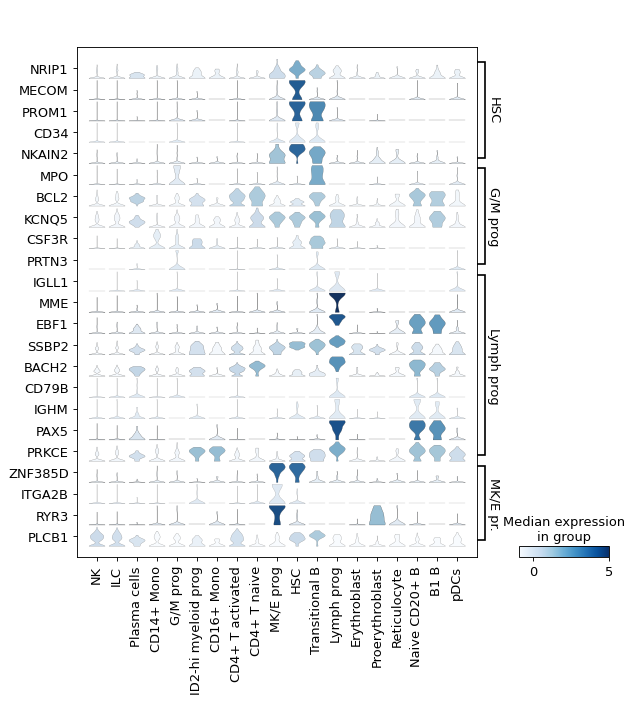

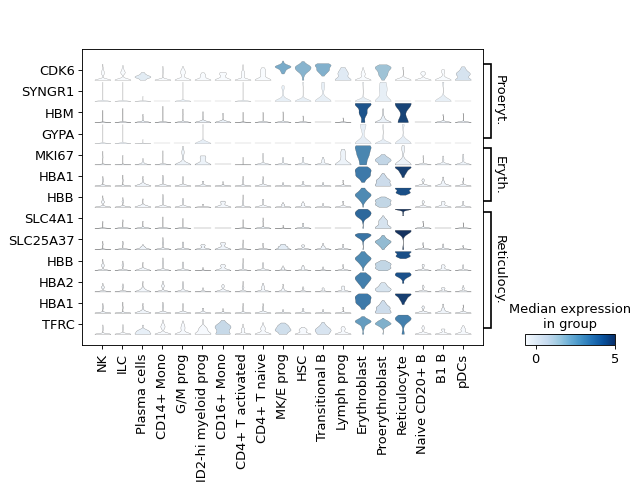

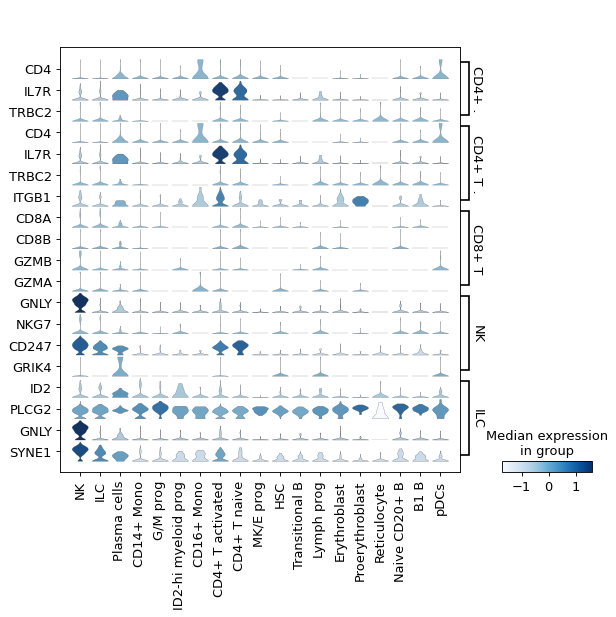

In [244]:
#Overview
adata_plot = adata_gex_filt.copy()
sc.pp.scale(adata_plot, max_value=5)

#Monocytes
sc.pl.stacked_violin(adata_plot, groupby='leiden_final', use_raw=False, swap_axes=True,                     
                     var_names={a:marker_genes[a] for a in ['CD14+ Mono', 'ID2-hi myeloid prog', 'CD16+ Mono', 'pDCs', 'cDC2']})

#B cells
sc.pl.stacked_violin(adata_plot, groupby='leiden_final', use_raw=False, swap_axes=True,                     
                     var_names={a:marker_genes[a] for a in ['Naive CD20+ B', 'B1 B', 'Transitional B', 'Plasma cells']})

#Progenitors
sc.pl.stacked_violin(adata_plot, groupby='leiden_final', use_raw=False, swap_axes=True,                     
                     var_names={a:marker_genes[a] for a in ['HSC', 'G/M prog', 'Lymph prog', 'MK/E prog']})

#Erythropoiesis
sc.pl.stacked_violin(adata_plot, groupby='leiden_final', use_raw=False, swap_axes=True,                     
                     var_names={a:marker_genes[a] for a in ['Proerythroblast', 'Erythroblast', 'Reticulocyte']})


#T & NK cells
sc.pl.stacked_violin(adata_plot, groupby='leiden_final', use_raw=False, swap_axes=True,                     
                     var_names={a:marker_genes[a] for a in ['CD4+ T naive', 'CD4+ T activated', 'CD8+ T', 'NK', 'ILC']})



# Write output

In [245]:
adata_gex_filt

AnnData object with n_obs × n_vars = 1797 × 14208
    obs: 'sample', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'n_counts', 'n_genes', 'size_factors', 'S_score', 'G2M_score', 'phase', 'leiden_res0.3', 'leiden_res0.5', 'leiden_res0.8', 'leiden_res1', 'doublet_score', 'predicted_doublet', 'leiden_res0.3_sub0', 'leiden_res0.3_sub1', 'leiden_res0.3_sub2', 'leiden_res0.3_sub3', 'leiden_res0.3_sub4', 'leiden_res0.3_sub5', 'leiden_res0.3_sub6', 'leiden_res0.3_sub7', 'leiden_final'
    var: 'gene_ids', 'feature_types', 'genome', 'mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'log1p', 'hvg', 'pca', 'neighbors', 'u

Saved annotated object not tidy object

In [246]:
pwd

'/home/jovyan/project/notebooks/s3d6_analysis'

In [247]:
adata_gex_filt.write('/home/jovyan/project/s3d6_data/s3d6_gex_annotated_not_tidy.h5ad')

In [252]:
adata_gex_filt_slim = adata_gex_filt.copy()
adata_gex_filt_slim.obs = adata_gex_filt.obs[['n_genes_by_counts', 'pct_counts_mt', 'n_counts', 'n_genes', 'size_factors', 'phase', 'leiden_final']]
adata_gex_filt_slim.var = adata_gex_filt.var[['gene_ids', 'feature_types', 'genome', 'n_cells', 'highly_variable']]

for i in ['log1p', 'phase_colors', 'leiden', 'leiden_res0.3_colors', 'leiden_res0.5_colors', 'leiden_res0.8_colors', 'leiden_res1_colors', 'predicted_doublet_colors', 
          'rank_genes_res0.3', 'leiden_res0.3_sub0_colors', 'rg_res0.3_sub0', 'leiden_res0.3_sub1_colors', 'rg_res0.3_sub1', 'leiden_res0.3_sub2_colors', 'rg_res0.3_sub2', 
          'rg_res0.3_sub3', 'leiden_res0.3_sub4_colors', 'rg_res0.3_sub4', 'rg_res0.3_sub5', 'leiden_res0.3_sub6_colors', 'rg_res0.3_sub6', 'leiden_res0.3_sub7_colors', 
          'rg_res0.3_sub7', 'leiden_final_colors']:
    del adata_gex_filt_slim.uns[i]
    
adata_gex_filt_slim

AnnData object with n_obs × n_vars = 1797 × 14208
    obs: 'n_genes_by_counts', 'pct_counts_mt', 'n_counts', 'n_genes', 'size_factors', 'phase', 'leiden_final'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'highly_variable'
    uns: 'hvg', 'pca', 'neighbors', 'umap'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'counts'
    obsp: 'distances', 'connectivities'

In [ ]:
adata_gex_filt_slim.write('../proc_data/Donor1_gex.h5ad')